<h1><center>Bird Species Image Recognition</center></h1>
<h3><center>Brendon Bottle and Sean McManus</center></h3>

In [1]:
import tensorflow as tf
from keras.layers import Dense, Conv2D, BatchNormalization, MaxPooling2D, Input, Flatten, Dropout, LeakyReLU
import numpy as np
import matplotlib.pyplot as plt
import os
import cv2
from sklearn.preprocessing import LabelBinarizer
import keras
from keras.models import Sequential, Model
from keras.callbacks import EarlyStopping, ModelCheckpoint
import random
from keras.applications import EfficientNetB0
import pandas as pd
import seaborn as sns
import warnings
import pickle

warnings.filterwarnings("ignore", "use_inf_as_na")

# Note on Randomness

In order to get reproducible results in this notebook, a random seed is set before each model call to ensure the weights are initalized the same way every time. When run on the same machine in the same environment, results should be identical every time. However, due to differences in computer environments, when this codebook is run on a different computer, the models converge in slightly different locations giving slightly different results. In general, we found that the themes presented in this code were consistent on both of our computers although the accuracy was slightly different and our models predicted species slightly differently.

# Load Data

Initial data source: https://www.kaggle.com/datasets/gpiosenka/100-bird-species

The inital dataset contained 100-200 images each for 525 species of bird. However, for learning and gaining knowledge on model architecture and design we determined that a smaller dataset that could be trained in a more reasonable amount of time would be more beneficial while still allowing us to explore the particular challenges of this dataset. As a comprimise we randomly selected 20 different species of bird to include in the model.

The available data for each bird was originally unbalanced, we corrected this by selecting a subset of the available images and creating a balanced dataset. This subset conatined 100 images for each of the 20 different species.

The validation and test sets were hand selected by the author of the kaggle dataset as they were considered good examples of that bird species, so we used the same he had selected as our validation and test sets. 

In [2]:
''' Original code for loading and saving data files. Outputs saved in pickle file and included with submission'''

# # Set file path for loading data
# train_dir = './birds/train'
# val_dir = "./birds/valid"
# test_dir = "./birds/test"

# # Set the number of images per bird to include
# num_img = 100
# num_birds = 20

# # Instantiate the containers for holding image and label data
# train_data = []
# val_data = []
# test_data = []

# bird_num = 0
# # Load train data
# for i in os.listdir(train_dir):
#     if i.startswith('.'):
#         continue
#     bird_num +=1
#     if bird_num > num_birds:
#         break
#     count = 0
#     sub_directory = os.path.join(train_dir, i)
#     for j in os.listdir(sub_directory):
#         count+=1
#         if count > num_img:
#             break
#         img = cv2.imread(os.path.join(sub_directory, j))
#         img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#         train_data.append([img, i])
    
            
# bird_num = 0
# # Load validation data
# for i in os.listdir(val_dir):
#     if i.startswith('.'):
#         continue
#     bird_num += 1
#     if bird_num > num_birds:
#         break
#     sub_directory = os.path.join(val_dir, i)
#     for j in os.listdir(sub_directory):
#         img = cv2.imread(os.path.join(sub_directory, j))
#         img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#         val_data.append([img, i])

# bird_num = 0
# #Load test data
# for i in os.listdir(test_dir):
#     if i.startswith('.'):
#         continue
#     bird_num += 1
#     if bird_num > num_birds:
#         break
#     sub_directory = os.path.join(test_dir, i)
#     for j in os.listdir(sub_directory):
#         img = cv2.imread(os.path.join(sub_directory, j))
#         img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#         test_data.append([img, i])

# print(len(train_data))
# print(len(val_data))
# print(len(test_data))

# pickle.dump(train_data, open('./saved_data/bird_train_data.pkl', 'wb'))
# pickle.dump(val_data, open('./saved_data/bird_val_data.pkl', 'wb'))
# pickle.dump(test_data, open('./saved_data/bird_test_data.pkl', 'wb'))

' Original code for loading and saving data files'

During data loading we had issues with being on different OS platforms, and filestructures. We solved this issue by using a pickle file to ensure images and birds were being loaded in the same order for all users. Pickle files can be accessed at https://drive.google.com/drive/folders/1y201lLV8aTEtB8oB2rpQd8q8wqoRJggp?usp=sharing

In [90]:
num_birds = 20
num_img = 100

train_data = pickle.load(open('./saved_data/bird_train_data.pkl', 'rb'))
val_data = pickle.load(open('./saved_data/bird_val_data.pkl', 'rb'))
test_data = pickle.load(open('./saved_data/bird_test_data.pkl', 'rb'))

In [91]:
bird_names = ['ALEXANDRINE PARAKEET',
 'ARARIPE MANAKIN',
 'ASIAN CRESTED IBIS',
 'BALD EAGLE',
 'BALD IBIS',
 'BLUE HERON',
 'BOBOLINK',
 'BORNEAN PHEASANT',
 'CALIFORNIA QUAIL',
 'CAMPO FLICKER',
 'CEDAR WAXWING',
 'COPPERSMITH BARBET',
 'CUBAN TROGON',
 'D-ARNAUDS BARBET',
 'EURASIAN BULLFINCH',
 'EURASIAN GOLDEN ORIOLE',
 'FLAME TANAGER',
 'FRILL BACK PIGEON',
 'GAMBELS QUAIL',
 'GREAT KISKADEE']

In [5]:
# Check if all images are the same shape

count_t = 0
count_v = 0

for t in train_data:
    if t[0].shape != (224, 224, 3):
        count_t += 1
    
for v in val_data:
    if v[0].shape != (224, 224, 3):
        count_v += 1

print(f'There are {count_t} images of different shape in the train data.\nThere are {count_v} images of different shape in the validation data.')
    

There are 0 images of different shape in the train data.
There are 0 images of different shape in the validation data.


# Explore Data

The random selection of birds includes a wide variety of birds in size, coloration, shapes, and poses. The images are already closely cropped, and the birds are genreally centered, but there is a lot of background noise between the images. Particularly for the smaller birds that mostly are perched on top of plants. 

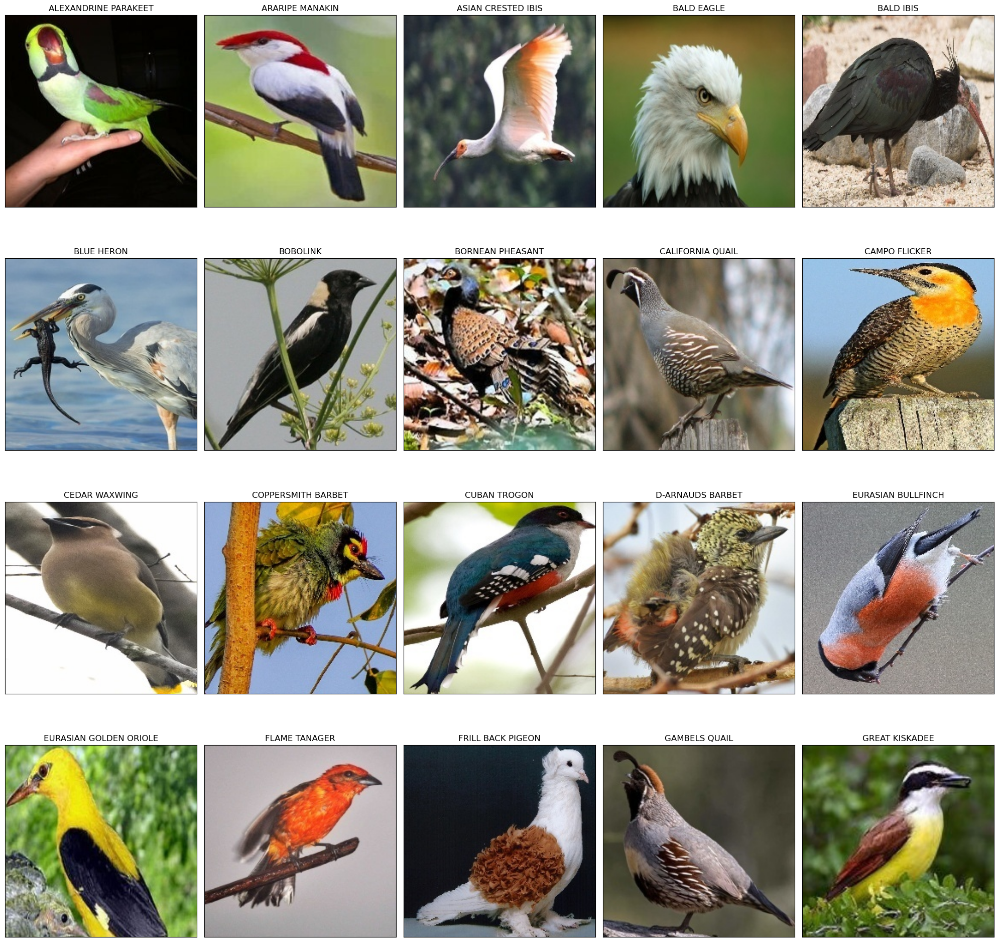

In [6]:
# Show an image for each bird
fig, axs = plt.subplots(int(num_birds/5), 5, figsize=(20, 20))

axs = axs.ravel()

ax = 0
for idx in np.arange(0, num_birds*num_img, num_img):
    bird = train_data[idx][1]
    img = train_data[idx][0]
    axs[ax].xaxis.set_ticks([])
    axs[ax].yaxis.set_ticks([])
    axs[ax].set_title(bird)
    # Note that cv2 reads images in BGR, but plt.imshow is expecting RGB, cvtColor reverses the channels so the correct color is shown when plotted. 
    axs[ax].imshow(img)
    ax +=1

plt.tight_layout()
plt.show()

# Preapre Data for Training

Because this is image data, and we've already confirmed they are the same shape, there is less cleaning than we'd need to do with other types of data. However, we do need to prepare the data for our model. We'll need to do a few things for this:

- Shuffle the data in case the images were loaded in any particular order. 
- Split the X features (pixel information) and y labels (bird names)
- Vectorize the y values to allow for machine interpretation. 

Because the baseline model we'll use (EfficientNet) has a scaling layer added into it already, we won't normalize the data here. Instead we'll do that as needed in the function calls.

In [92]:
# Shuffle data to randomize batches

np.random.seed(rs)
np.random.shuffle(train_data)
np.random.shuffle(val_data)

In [93]:
# Preprocess training data and validation data
lb = LabelBinarizer()

X_train = []
y_train = []
for x, y in train_data:
    X_train.append(x)
    y_train.append(y)

X_train = np.array(X_train)
y_train = np.array(y_train)

y_train_vect = lb.fit_transform(y_train)

X_val = []
y_val = []
for x, y in val_data:
    X_val.append(x)
    y_val.append(y)

X_val = np.array(X_val)
y_val = np.array(y_val)

y_val_vect = lb.fit_transform(y_val)

# Function Creation

We'll first create few functions that we'll need for running and evaluating models.

In [9]:
def set_callbacks(filename, patience= 8, start_from_eopch= 10):

    '''Sets early stopping and model checkpoint variables
    
        Args:
            filename (str): Filename/path for saving
            patience (int): How many epochs to wait before stopping (default 8)
            start_from_epoch (int): What epoch to start checking validation accuracy (default 10)

        Returns:
            stopping: EarlyStopping call
            checkpoint: ModelCheckpoint call
    '''

    stopping = EarlyStopping(monitor= 'val_accuracy', patience= 8, start_from_epoch=10, restore_best_weights= True)
    checkpoint = ModelCheckpoint(filename, monitor = 'val_accuracy', save_best_only= True)

    return stopping, checkpoint

def plot_loss (mod_hist):

    '''Plots the loss and accuracy for model training
    
        Args:
            mod_hist: History results from a model.fit() call
    '''

    results_df = pd.DataFrame({'Train Accuracy': mod_hist.history['accuracy'],
                           'Val Accuracy': mod_hist.history['val_accuracy'],
                           'Train Loss': mod_hist.history['loss'],
                           'Val Loss': mod_hist.history['val_loss']
                           })

    fig, axs = plt.subplots(ncols=2, figsize = (12, 4))

    sns.lineplot(results_df['Val Loss'], ax= axs[0], label = 'Val Loss')
    sns.lineplot(results_df['Train Loss'], ax= axs[0], label = 'Train Loss')

    sns.lineplot(results_df['Val Accuracy'], ax= axs[1], label = 'Val Acc')
    sns.lineplot(results_df['Train Accuracy'], ax= axs[1], label = 'Train Acc')

    # axs[1].set_yticks(np.arange(.1, 1.01, .05))
    # axs[0].set_yticks(np.arange(0, 5.1, .2))

    plt.legend()

    plt.show()

def model_setup(rs=7284):
    '''Sets the 3 seeds necessary for consistency in keras'''
    np.random.seed(rs)
    random.seed(rs)
    tf.random.set_seed(rs)
    
def resize_img(X_train ,X_val, new_size):
    '''Resizes an array of images

        Args:
            X_train (array): Array of image data for training
            X_val (array): Array of img data for validation
            new_size (tuple): The shape to resize the images to

        Returns:
            X_train_rs (array): An array of the same length as X_train with images resized
            X_val_rs (array): An array of the same length as X_val with images resized

    '''
    X_train_rs = []
    X_val_rs = []

    #Resize training data
    for img in X_train:
        rsimg = cv2.resize(img, new_size)
        X_train_rs.append(rsimg)

    X_train_rs = np.array(X_train_rs)

    # Resize validation data
    for img in X_val:
        rsimg = cv2.resize(img, new_size)
        X_val_rs.append(rsimg)

    X_val_rs = np.array(X_val_rs)

    return X_train_rs, X_val_rs

def pred_eval(model, X = X_val, y= y_val):

    ''' Evaluates predictions for specificed model

        Args:
            model: The model to be used for predictions

        Returns:
            preds (df): A dataframe of the ground truth and predicted class labels for each observation
    
    '''
     
    predictions = np.argmax(model.predict(X/255), axis=1)

    y_hat = np.array([bird_names[i] for i in predictions])

    preds = pd.DataFrame({'y_true': y,
                                'y_hat': y_hat
                                })
    
    return preds

def count_correct(preds):

    '''Creates a dummary dataframe counting the total correct predictions for each bird species
    
        Args:
            preds (df): The output dataframe from pred_eval()

        Returns:
            correct_count(df): A dataframe with each bird name and the total number correctly predicted
    '''

    # Look at number of correct predictions for each bird
    preds['Correct'] = preds.apply(lambda x: 0 if x['y_true'] != x['y_hat'] else 1, axis= 1)

    correct_count = pd.DataFrame(preds.groupby(by='y_true').sum()['Correct'])

    return correct_count

def show_class(bird, preds, X = X_val):

    '''Shows validation images and predicted class for specified species, divided by incorrect and correct if applicable

        Args:
            bird (str): Name of bird to show
            preds (df): The output dataframe from pred_eval()
    '''

    # List the indexes for the worst bird correctly and incorrectly predicted and show images
    wrong_bird = list(preds[(preds['y_true'] == bird) & (preds['y_hat'] != bird)].index)
    right_bird = list(preds[(preds['y_true'] == bird) & (preds['y_hat'] == bird)].index)

    if len(wrong_bird) > 0:

        print(f'Incorrectly labeled {bird}')
        fig, axs = plt.subplots(ncols=len(wrong_bird), figsize = (15, 5))

        for idx, i in enumerate(wrong_bird):
            if len(wrong_bird) > 1:
                ax = axs[idx]
            elif len(wrong_bird) <= 1:
                ax = axs

            ax.imshow(X[i])
            ax.xaxis.set_ticks([])
            ax.xaxis.set_ticks([])
            ax.set_title(preds['y_hat'][i])
            ax.axis('off')
        
        plt.tight_layout()
        plt.show()

    if len(right_bird) > 0: 

        print(f'Correctly labeled {bird}')

        fig, axs = plt.subplots(ncols=len(right_bird), figsize = (10, 5))

        for idx, i in enumerate(right_bird):

            if len(right_bird) > 1:
                ax = axs[idx]
            elif len(right_bird) <= 1:
                ax = axs

            ax.imshow(X[i])
            ax.xaxis.set_ticks([])
            ax.xaxis.set_ticks([])
            ax.set_title(preds['y_hat'][i])
            ax.axis('off')
            
        plt.tight_layout()
        plt.show()

def plot_birds(birds, num_show):
    '''Shows the selected number of images from teh training set for the selected species of birds
    
        Args:
            birds (list): A list of the name(s) of bird(s) that you want to show
            num_show(int): The number of images to show for each species
    '''
    for bird in birds:
        fig, axs = plt.subplots(ncols= num_show, figsize = (20, 5))

        bird_imgs = X_train[y_train == bird][:num_show]

        for idx, b in enumerate(bird_imgs):

            axs[idx].imshow(b)
            axs[idx].xaxis.set_ticks([])
            axs[idx].xaxis.set_ticks([])
            axs[idx].axis('off')
            
        fig.suptitle(bird)
        plt.tight_layout()
        plt.show()


# Check Baseline

To validate that this is a problem we'll be able to solve with a reasonable level of accuracy, we'll set a baseline expectation for how well our model could potentially perform using EfficientNetB0, a popular pre-trained model used for image classification. We'll just run it for 5 epochs to get an idea of what kind of accuracy we might expect to be able to get from this dataset.

In [94]:
# Just running a couple epochs on baseline to validate that it should still be able to get decent results
keras.backend.clear_session()
model_setup()
# Load Model 
enet = EfficientNetB0(include_top= False, input_shape=(224, 224, 3), weights= 'imagenet')

layers = enet.layers

for layer in layers:
    layer.trainable = False

# Add a flatten and softmax layer
base_model= Sequential([
    enet,
    Flatten(),
    Dense(num_birds, activation='softmax')
])

# Compile model
base_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

base_history = base_model.fit(x = X_train, y= y_train_vect, batch_size=80, validation_data= (X_val, y_val_vect), verbose = 1, epochs = 5)

Epoch 1/5
25/25 [==============================] - 19s 611ms/step - loss: 0.9192 - accuracy: 0.8315 - val_loss: 0.2380 - val_accuracy: 0.9600
Epoch 2/5
25/25 [==============================] - 13s 541ms/step - loss: 0.1177 - accuracy: 0.9835 - val_loss: 0.0883 - val_accuracy: 0.9800
Epoch 3/5
25/25 [==============================] - 13s 534ms/step - loss: 0.0199 - accuracy: 0.9960 - val_loss: 0.0258 - val_accuracy: 0.9900
Epoch 4/5
25/25 [==============================] - 14s 543ms/step - loss: 0.0130 - accuracy: 0.9950 - val_loss: 0.0015 - val_accuracy: 1.0000
Epoch 5/5
25/25 [==============================] - 14s 548ms/step - loss: 0.0029 - accuracy: 0.9995 - val_loss: 0.0018 - val_accuracy: 1.0000


# Simple Model

With only 5 epochs, we already had an accuracy of 100%, so this is clearly a problem that can be solved very well by a properly trained neural net. To give ourselves a starting point, we'll build a very simple model just using 1 CNN layer, a pooling layer, and a softmax for predictions. We'll use 32 filters, a 3x3 kernel, a leaky ReLu activation function, and rmsprop as an optimizer. Because we balanced our classes, accuracy will be a reasonable metric to use for evaluation, although we will want to check the actual class predictions to determine which classes our model struggles with the most. 

We'll use early stopping to limit run times.

In [11]:
# Clears any keras global varaibles such as layer names
keras.backend.clear_session()

# Sets the three random seeds for reproducibility of weight initialization
model_setup()

inputs = Input(shape=(224, 224, 3))

cnn1 = Conv2D(32, 3, activation="leaky_relu")(inputs)

pool1 = MaxPooling2D(2)(cnn1)

flat = Flatten()(pool1)

predictions = Dense(num_birds, activation='softmax')(flat)

simp_model = Model(inputs=inputs, outputs=predictions)

simp_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 flatten (Flatten)           (None, 394272)            0         
                                                                 
 dense (Dense)               (None, 20)                7885460   
                                                                 
Total params: 7886356 (30.08 MB)
Trainable params: 7886356 (30.08 MB)
Non-trainable params: 0 (0.00 Byte)
_____________________

In [12]:
# Fit model
stopping, checkpoint = set_callbacks('./saved_models/simple_model.keras')

simp_model.compile(optimizer='rmsprop', loss= 'categorical_crossentropy', metrics=['accuracy'])

simp_history = simp_model.fit(x = X_train/255, y= y_train_vect, batch_size=128, validation_data= (X_val/255, y_val_vect), verbose = 0, epochs = 100, callbacks=[stopping, checkpoint])

simp_model.evaluate(X_val/255, y_val_vect)

4/4 [==============================] - 0s 35ms/step - loss: 0.8571 - accuracy: 0.8100


[0.8571308851242065, 0.8100000023841858]

## Model Evaluation

Our model performed suprisingly well for such a simple model. With only 21 epochs we were able to get our model up to 81% accuracy before it plateaued. However, looking at our loss and accuracy over the epochs, we can see that the model is trending towards overfitting. Our training accuracy jumps up to 100% relatively quickly while the validation accuracy seems to have leveled out, and is starting to drop as we reach the 20th epoch.

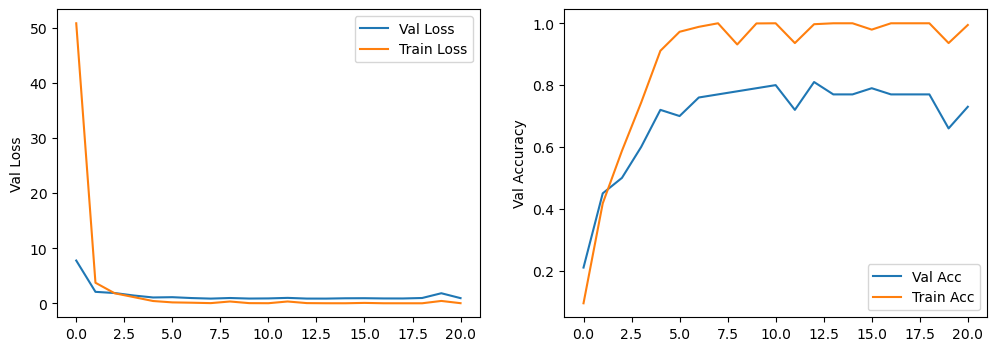

In [13]:
# Look at epoch loss/accuracy
plot_loss(simp_history)

## Prediction Evaluation

Looking at predictions by class, we can see that while the overall accuracy was good, several species are being very poorly classified including Frill Back Pigeon and Blue Heron.

In [14]:
simp_preds = pred_eval(simp_model)
simp_correct_count = count_correct(simp_preds)

correct_overall = simp_correct_count

correct_overall.columns = ['Simple']

correct_overall.sort_values('Simple')

4/4 [==============================] - 0s 35ms/step


,Simple
y_true,
FRILL BACK PIGEON,2
BLUE HERON,2
FLAME TANAGER,3
BALD EAGLE,3
D-ARNAUDS BARBET,3
CEDAR WAXWING,3
CAMPO FLICKER,4
BALD IBIS,4
BOBOLINK,4


## Images of Incorrect Bird Classifications

Examining the images of those two classes, we can see that the Frill Back Pigeon comes in a variety of colors, and the frill on its back is very different in each picture. The Blue Heron has a wide variety of poses it can take, and depending on the lighting, can have very different coloration but doesn't have any consistent distinctive patterns.

Examining the species that these birds were confused with, it appears our model is making some odd conclusions about these birds that a human would not make based on the images. Comparing these images, it appears that color is the most indicative feature for how a bird will get predicted, although it's often hard to identify exactly how the model matched that. 

Incorrectly labeled FRILL BACK PIGEON


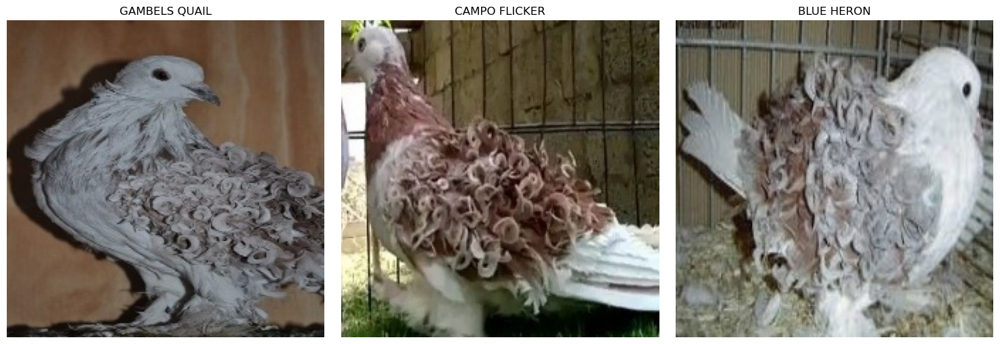

Correctly labeled FRILL BACK PIGEON


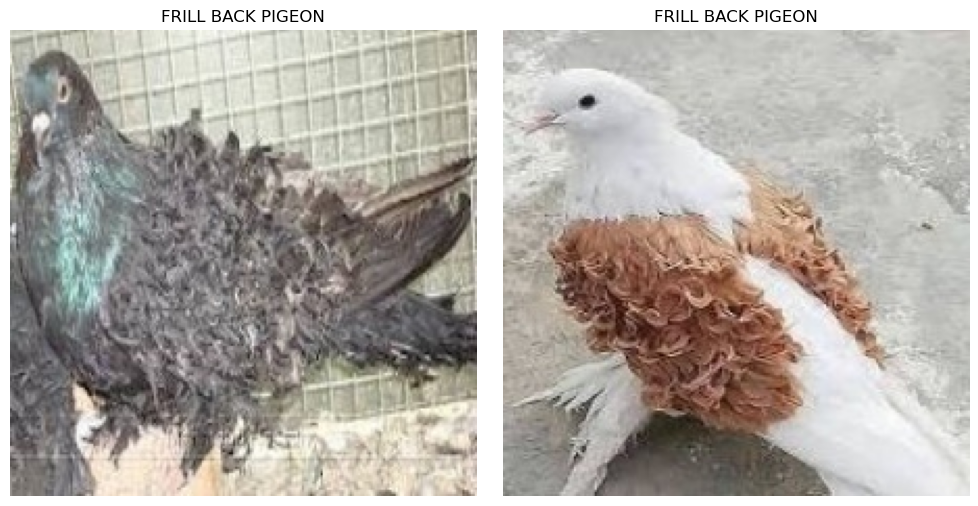

Incorrectly labeled BLUE HERON


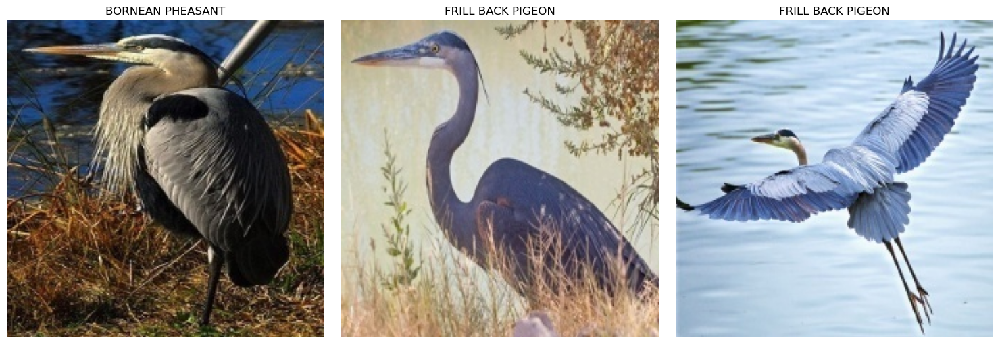

Correctly labeled BLUE HERON


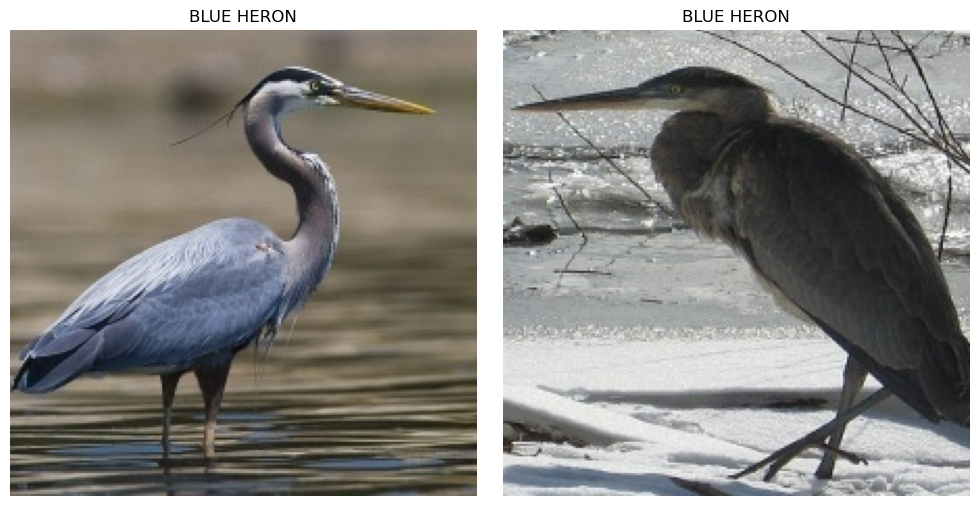

In [15]:
show_class('FRILL BACK PIGEON', simp_preds)

show_class('BLUE HERON', simp_preds)

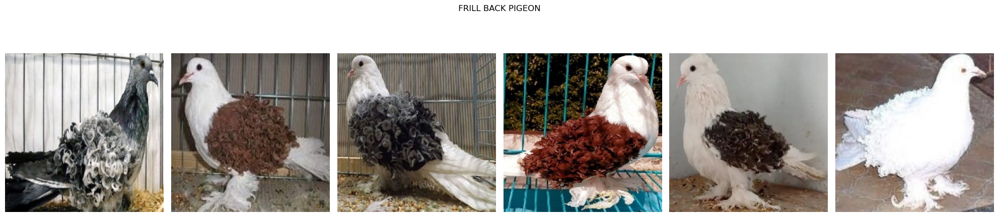

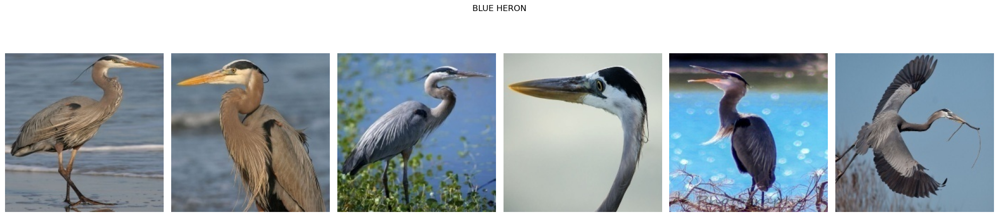

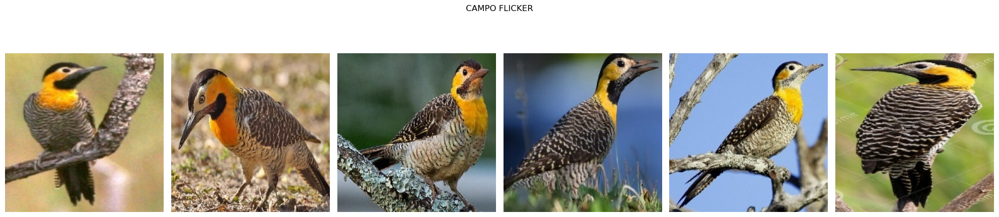

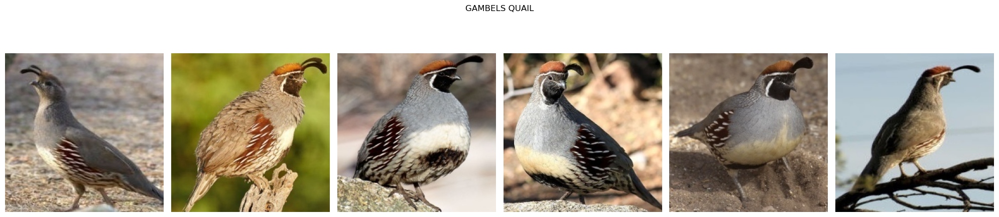

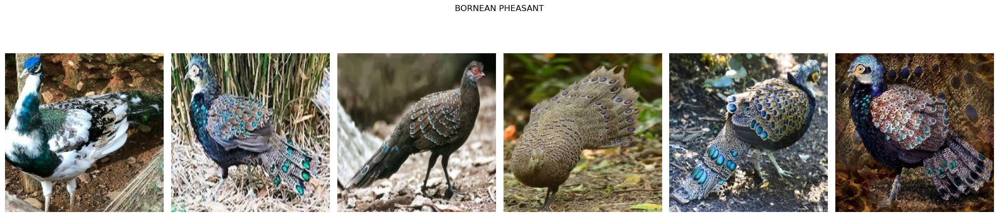

In [16]:
plot_birds(['FRILL BACK PIGEON', 'BLUE HERON', 'CAMPO FLICKER', 'GAMBELS QUAIL', 'BORNEAN PHEASANT'], 6)

## Images of Correct Bird Classifications

Exploring some of the birds that were well classified, we can see that they contain very distinct features including a very well defined red patch on the Cuban Trogon and a distinctive plume on the Gamble's Quail.

This would indicate that while the model is focused on color, it's also picking out very distinctive shapes from the images. 

Correctly labeled CUBAN TROGON


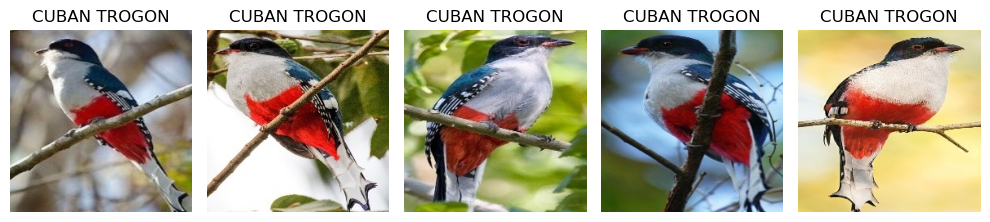

Correctly labeled GAMBELS QUAIL


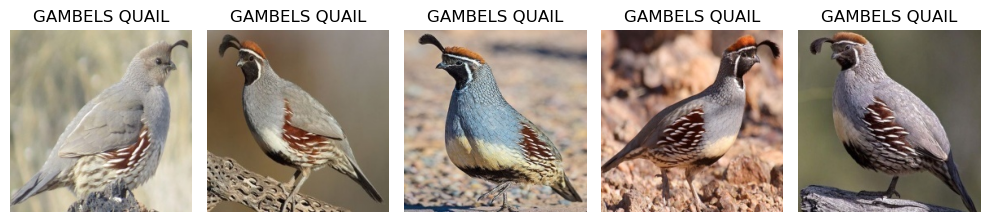

In [17]:
# Look at correctly classified birds

show_class('CUBAN TROGON', simp_preds)
show_class('GAMBELS QUAIL', simp_preds)


# Model Complexity Test

After evaluating these classes, it indicated to us that the model was focusing largely on very shallow features, making it an excellent predictor for distinctive birds, and poor classifier for less distinctive or highly varied birds.

To help model learn more features, we increased teh complexity fo the model. We introduced two CNN layers to extract and differentiate more features and included a MaxPooling layer to support model invaraince. 

In [18]:
keras.backend.clear_session()
model_setup()

comp_model = Sequential()

comp_model.add(Conv2D(32, 3, activation='leaky_relu', input_shape=(224, 224, 3)))

comp_model.add(MaxPooling2D(2))

comp_model.add(Conv2D(32, 3, activation='leaky_relu'))

comp_model.add(MaxPooling2D(2))

comp_model.add(Conv2D(32, 3, activation='leaky_relu'))

comp_model.add(MaxPooling2D(2))

comp_model.add(Flatten())

comp_model.add(Dense(num_birds, activation='softmax'))

comp_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 32)      9248      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 32)        9248      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 26, 26, 32)        0

In [19]:
stopping, checkpoint = set_callbacks('complex_model.keras')

comp_model.compile(optimizer='rmsprop', loss= 'categorical_crossentropy', metrics=['accuracy'])

comp_history = comp_model.fit(x = X_train/255, y= y_train_vect, batch_size=128, validation_data= (X_val/255, y_val_vect), verbose = 0, epochs = 100, callbacks=[stopping, checkpoint])

comp_model.evaluate(X_val/255, y_val_vect)

4/4 [==============================] - 0s 35ms/step - loss: 1.1084 - accuracy: 0.7900


[1.1083741188049316, 0.7900000214576721]

## Model Evaluation

Accuracy did not improve on this version of the model, and our model appeared to be overfitting more when comparing the loss values to the simple model. 

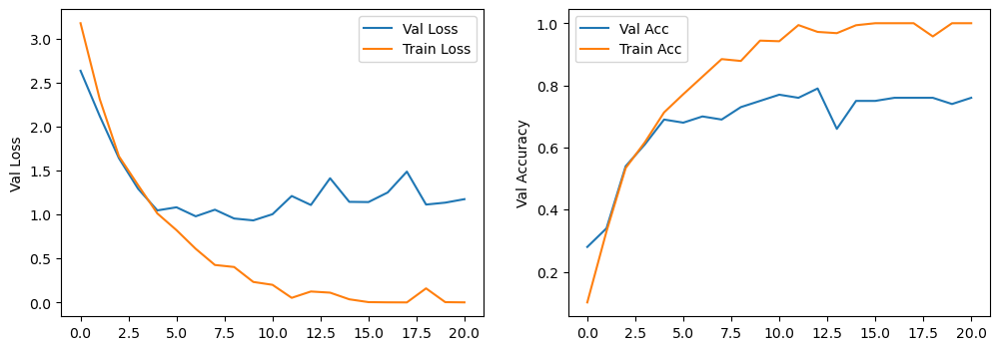

In [20]:
plot_loss(comp_history)

## Prediction Evaluation

Exploring the individual class predictions, there were significant improvements, for instance the Frill Back Pigeon was much better classified, but other birds became much worse including the Bald Eagle and Bald Ibis. While the additional layers seemed to have helped the mode learn new information, they also resulted in it unlearning relevant features for other birds.

In [21]:
comp_preds = pred_eval(comp_model)
comp_correct = count_correct(comp_preds)

correct_overall['Complex'] = comp_correct['Correct']

correct_overall.sort_values('Complex')

4/4 [==============================] - 0s 23ms/step


,Simple,Complex
y_true,,
BALD EAGLE,3,1
BALD IBIS,4,2
EURASIAN GOLDEN ORIOLE,4,2
BLUE HERON,2,3
BOBOLINK,4,3
CEDAR WAXWING,3,3
D-ARNAUDS BARBET,3,3
FRILL BACK PIGEON,2,4
ASIAN CRESTED IBIS,5,4


## Images of Incorrect Classifications

The Bald Eagle was particularly confusing, as it was very unclear what the model was using to make its predictions, while others made more sense since there were some color or pattern similarities such as the Flame Tanager and Eurasian Golden Oriole

Incorrectly labeled BALD EAGLE


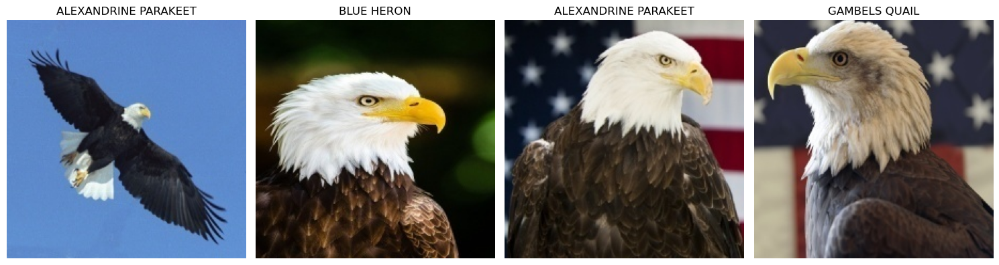

Correctly labeled BALD EAGLE


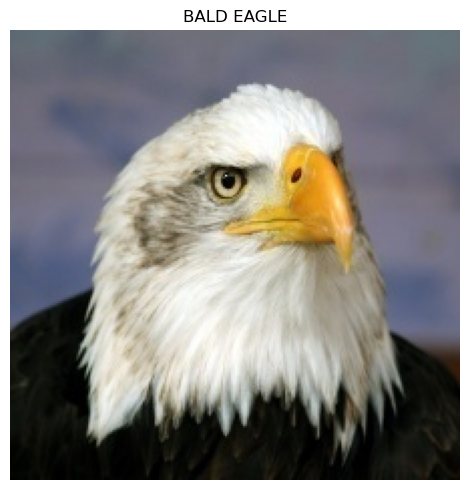

Incorrectly labeled BALD IBIS


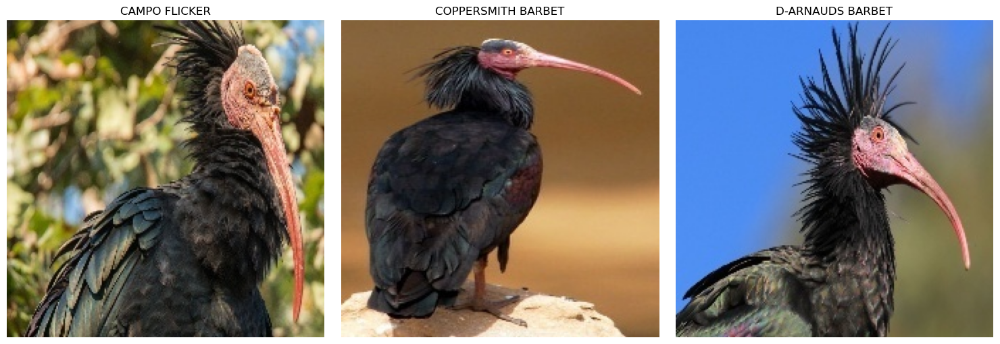

Correctly labeled BALD IBIS


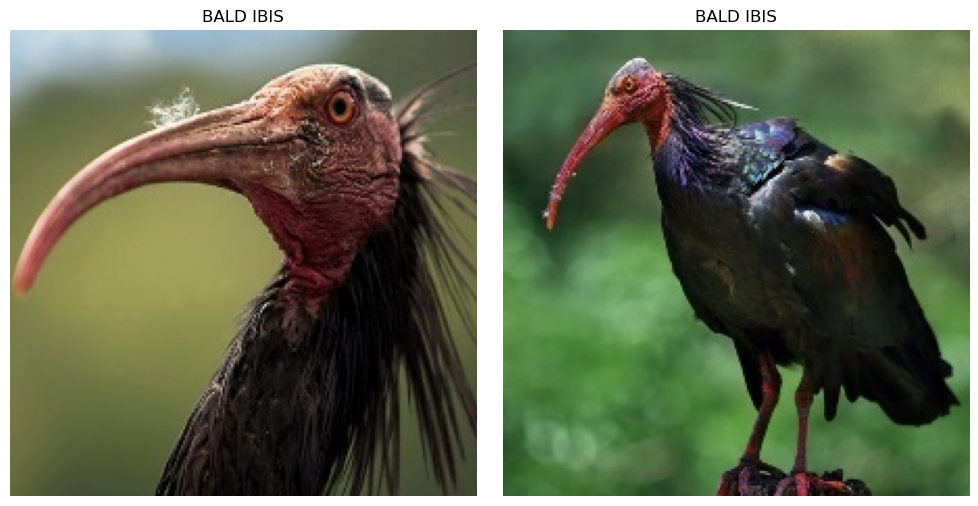

Incorrectly labeled EURASIAN GOLDEN ORIOLE


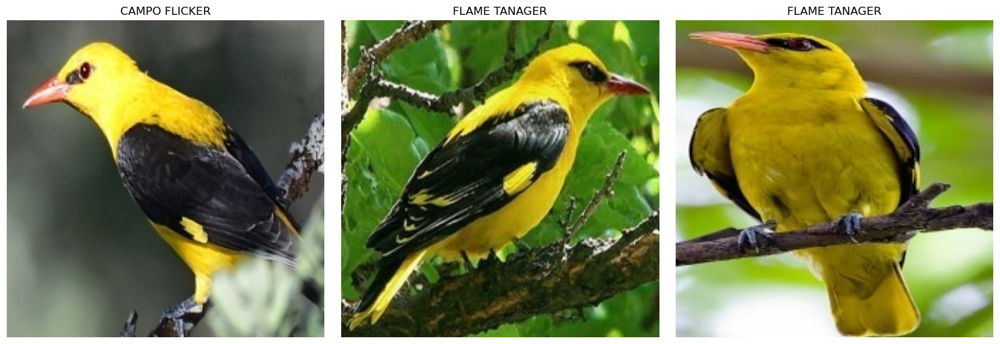

Correctly labeled EURASIAN GOLDEN ORIOLE


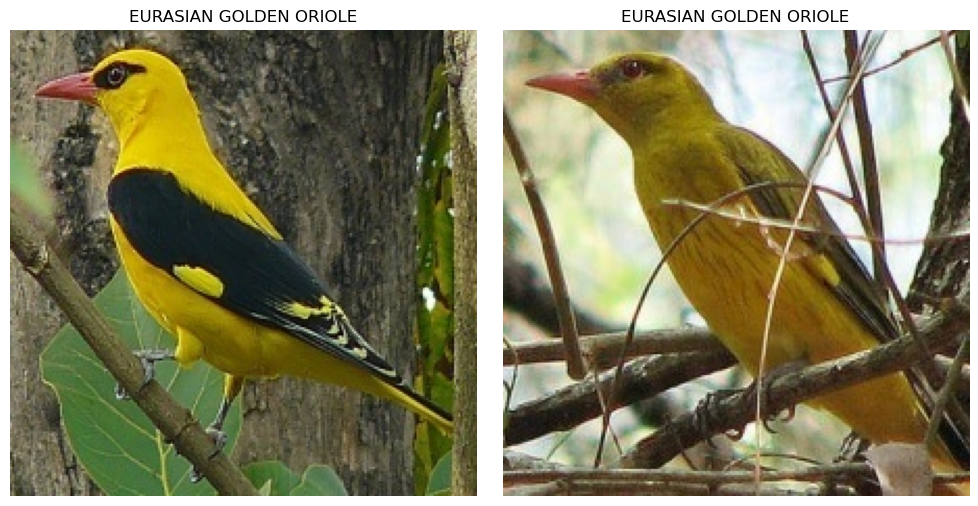

In [22]:
show_class('BALD EAGLE', comp_preds)

show_class('BALD IBIS', comp_preds)

show_class('EURASIAN GOLDEN ORIOLE', comp_preds)

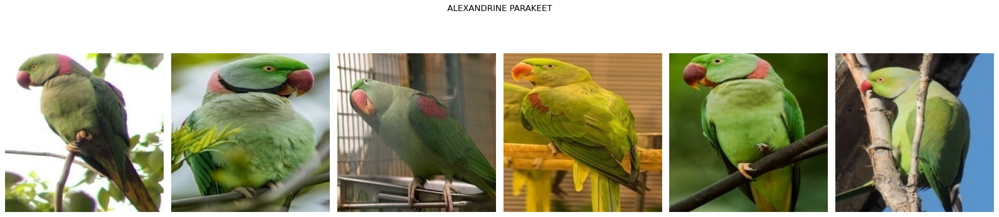

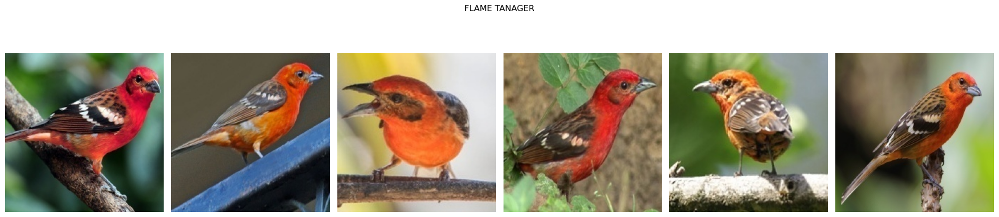

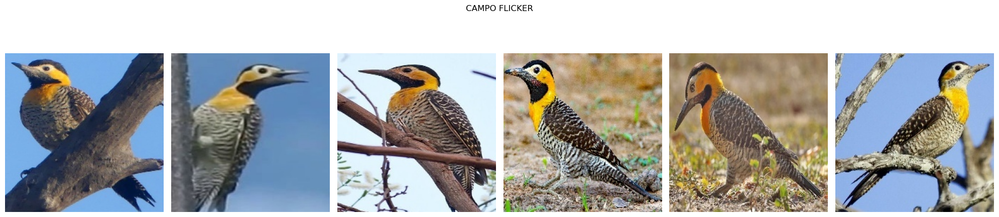

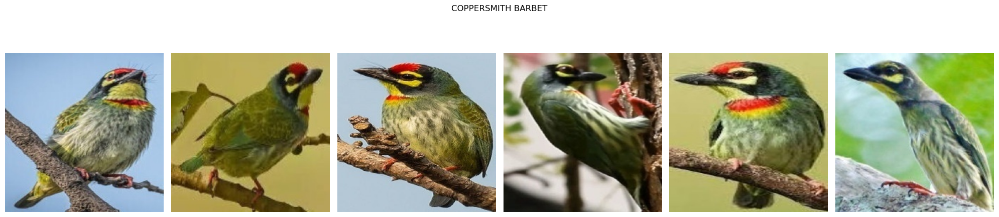

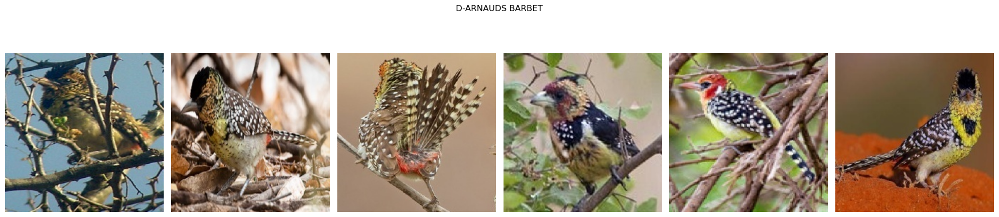

In [70]:
plot_birds(['ALEXANDRINE PARAKEET', 'FLAME TANAGER', 'CAMPO FLICKER', 'COPPERSMITH BARBET', 'D-ARNAUDS BARBET'], 6)

## Images of Correct Classifications

Looking at two of the birds that improved, we were once again seeing very distinctive patterns and colors. The Distinct yellow head on the Campo Flicker and the Green and Red colors on the Barbet seemed like they were likely the reasons for the improved predictions. 

Correctly labeled CAMPO FLICKER


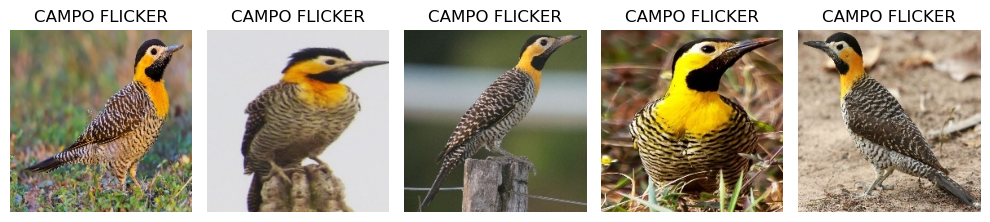

Correctly labeled COPPERSMITH BARBET


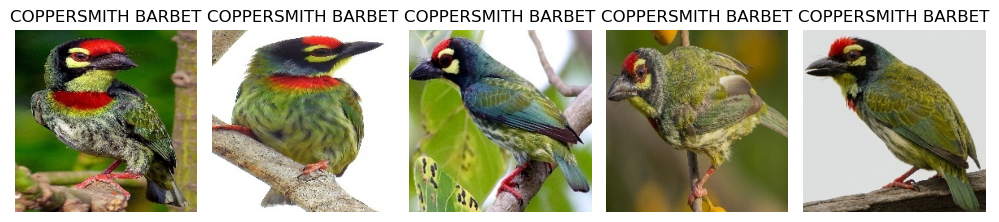

In [71]:
show_class('CAMPO FLICKER', comp_preds)

show_class('COPPERSMITH BARBET', comp_preds)

# Grayscale Model Testing

To validate our assumption that color was playing a significant role in the predictions, we re-trained our model on grayscale images to see which of the birds were still being well classified. 

In [24]:
grey_train = []
for i,j in train_data:
    img = cv2.cvtColor(i, cv2.COLOR_BGR2GRAY)
    grey_train.append([img, j])
print(len(grey_train))

grey_val = []
for i,j in val_data:
    img = cv2.cvtColor(i, cv2.COLOR_BGR2GRAY)
    grey_val.append([img, j])
print(len(grey_val))


2000
100


In [25]:
# prep greyscale data
# Shuffle data to randomize batches
np.random.seed(rs)
np.random.shuffle(grey_train)
np.random.shuffle(grey_val)

X_grey_train = []
y_grey_train = []
for x, y in grey_train:
    X_grey_train.append(x)
    y_grey_train.append(y)

X_grey_train = np.array(X_grey_train)
y_grey_train = np.array(y_grey_train)

y_grey_train_vect = lb.fit_transform(y_grey_train)

X_grey_val = []
y_grey_val = []
for x, y in grey_val:
    X_grey_val.append(x)
    y_grey_val.append(y)

X_grey_val = np.array(X_grey_val)
y_grey_val = np.array(y_grey_val)

y_grey_val_vect = lb.fit_transform(y_grey_val)

In [26]:
keras.backend.clear_session()
model_setup()

grey_model = Sequential()

grey_model.add(Conv2D(32, 3, activation='leaky_relu', input_shape=(224, 224, 1)))

grey_model.add(MaxPooling2D(2))

grey_model.add(Conv2D(32, 3, activation='leaky_relu'))

grey_model.add(MaxPooling2D(2))

grey_model.add(Conv2D(32, 3, activation='leaky_relu'))

grey_model.add(MaxPooling2D(2))

grey_model.add(Flatten())

grey_model.add(Dense(num_birds, activation='softmax'))

grey_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 111, 111, 32)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 32)      9248      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 54, 54, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 32)        9248      
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 26, 26, 32)        0

In [27]:
# Fitting the greyscale model

stopping, checkpoint = set_callbacks('grey_model.keras')

grey_model.compile(optimizer='rmsprop', loss= 'categorical_crossentropy', metrics=['accuracy'])

grey_history = grey_model.fit(x = X_grey_train/255, y= y_grey_train_vect, batch_size=128, validation_data= (X_grey_val/255, y_grey_val_vect), verbose = 0, epochs = 100,callbacks=[stopping, checkpoint])

#print(grey_history.history.keys())
max_val = max(grey_history.history['val_accuracy'])
max_train = max(grey_history.history['accuracy'])

print(f'The maximum traing accuracy was {round(max_train,3)} \nThe maximum validation accuracy was {round(max_val,3)} ')

The maximum traing accuracy was 1.0 
The maximum validation accuracy was 0.57 


## Prediction Evaluation

As expected, some of the species with very distinct colors were now being very poorly classified. Other birds that had very distinctive feather shapes such as the California Quail, or very particular patterns to their coloring like the Cuban Trogon, were still being failry well calssified. 

In [28]:
grey_preds = pred_eval(grey_model, X = X_grey_val, y=y_grey_val)
grey_correct = count_correct(grey_preds)

correct_overall['Gray'] = grey_correct['Correct']

correct_overall.sort_values('Gray')

4/4 [==============================] - 0s 33ms/step


,Simple,Complex,Gray
y_true,,,
ALEXANDRINE PARAKEET,5,5,1
FLAME TANAGER,3,4,1
EURASIAN GOLDEN ORIOLE,4,2,1
COPPERSMITH BARBET,4,5,1
D-ARNAUDS BARBET,3,3,2
CAMPO FLICKER,4,5,2
BALD EAGLE,3,1,2
GREAT KISKADEE,5,5,2
BOBOLINK,4,3,3


# Progressive Resizing Model

Clearly color is a very important part of identifying birds, even for human observers, so we couldn't drop color from our model and still expect it to perform well. However, we wanted to see if we could move the model away from focusing so much on the very distinct features, and help it learn more general features that might help it learn thigns about the other species.

We employed progressive resizing, a method to train the model on lower quality images, and progressively adding in new layers trained on higher quality images. The goal is to preven the later layers in the model from being influenced by noise in the higher quality images, or in our case the distinctive patterning the model was learning. 

We chose to use 3 levels of resizing: 56x56, 112x112, and 224x224.

## 56x56

The base of our model started with the complex model designed in the previous step. We then increased the number of filters to 128, 64, and 32 on the 3 convolutional layers in order to pull out more features from the lower quality images. 

We also added an additional fully connected layer ahead of the softmax layer to provide additional feature differentiation on the entirety of the image.

To combat overfitting, we added Dropout layer with a rate of 20% after the last MaxPooling layer. And because we introduced the dropout, we also removed our early stopping parameter and allowed each model to run for 100 epochs.

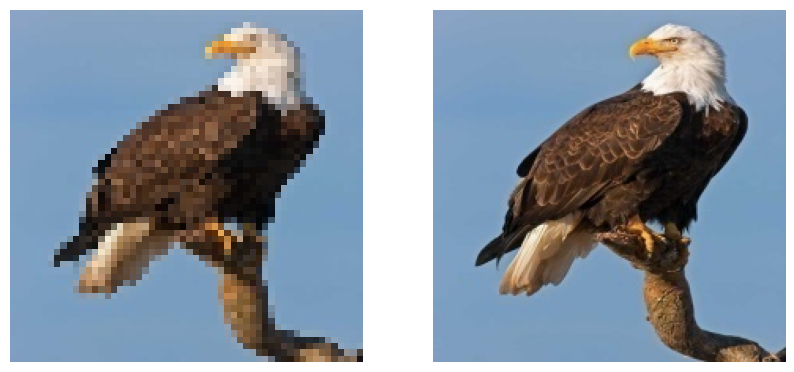

In [29]:
# Resize imags to 56x56

X_train_56, X_val_56 = resize_img(X_train, X_val, (56, 56))

fig, axs = plt.subplots(ncols=2, figsize = (10, 10))

# Compare to original data

axs[0].imshow(X_train_56[5])
axs[0].axis('off')

axs[1].imshow(X_train[5])
axs[1].axis('off')
plt.show()

In [30]:
# Create model to train 56x56 images

keras.backend.clear_session()
model_setup()

model = Sequential()

# Need to add 2nd conv2D layer so that it can become the new input layer, setting padding as same to maintain matrix sizes
model.add(Conv2D(32, 3, activation='leaky_relu', padding='same', input_shape=(56, 56, 3)))

model.add(Conv2D(128, 3, activation='leaky_relu', padding='same'))

model.add(MaxPooling2D(2))

model.add(Conv2D(64, 3, activation='leaky_relu'))

model.add(MaxPooling2D(2))

model.add(Conv2D(32, 3, activation='leaky_relu'))

model.add(MaxPooling2D(2))

model.add(Dropout(.2))

model.add(Flatten())

model.add(Dense(128, activation='leaky_relu'))

model.add(Dense(num_birds, activation='softmax'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 56, 56, 32)        896       
                                                                 
 conv2d_1 (Conv2D)           (None, 56, 56, 128)       36992     
                                                                 
 max_pooling2d (MaxPooling2  (None, 28, 28, 128)       0         
 D)                                                              
                                                                 
 conv2d_2 (Conv2D)           (None, 26, 26, 64)        73792     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 13, 13, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_3 (Conv2D)           (None, 11, 11, 32)        1

In [31]:
# Set callbacks
stopping, checkpoint = set_callbacks('model_56.keras', patience=20)

# Build and bit model
model.compile(optimizer='RMSProp', loss='categorical_crossentropy', metrics='accuracy')

history_56 = model.fit(x = X_train_56/255, y= y_train_vect, batch_size=128, validation_data= (X_val_56/255, y_val_vect), verbose = 1, epochs = 100, callbacks=[checkpoint])

Epoch 1/100
16/16 [==============================] - 6s 371ms/step - loss: 3.0073 - accuracy: 0.0500 - val_loss: 2.9782 - val_accuracy: 0.0400
Epoch 2/100
16/16 [==============================] - 6s 353ms/step - loss: 2.9645 - accuracy: 0.1075 - val_loss: 3.0627 - val_accuracy: 0.1000
Epoch 3/100
16/16 [==============================] - 6s 356ms/step - loss: 2.6709 - accuracy: 0.1970 - val_loss: 2.3822 - val_accuracy: 0.2700
Epoch 4/100
16/16 [==============================] - 6s 366ms/step - loss: 2.4312 - accuracy: 0.2665 - val_loss: 2.1243 - val_accuracy: 0.3100
Epoch 5/100
16/16 [==============================] - 6s 363ms/step - loss: 2.0374 - accuracy: 0.3850 - val_loss: 1.6841 - val_accuracy: 0.4800
Epoch 6/100
16/16 [==============================] - 6s 357ms/step - loss: 1.8221 - accuracy: 0.4540 - val_loss: 1.7722 - val_accuracy: 0.4500
Epoch 7/100
16/16 [==============================] - 6s 348ms/step - loss: 1.6115 - accuracy: 0.5155 - val_loss: 1.4120 - val_accuracy: 0.5300

In [32]:
model_56 = keras.saving.load_model('model_56.keras')

model_56.evaluate(X_val_56/255, y_val_vect)

4/4 [==============================] - 0s 21ms/step - loss: 0.8063 - accuracy: 0.8900


[0.8062862157821655, 0.8899999856948853]

### Model Evaluation

Downscaling the images has given us a significant boost in accuracy and improved our loss as well.  We've also seen an improvement in overfitting, although our training model is still performing better than our validation. 

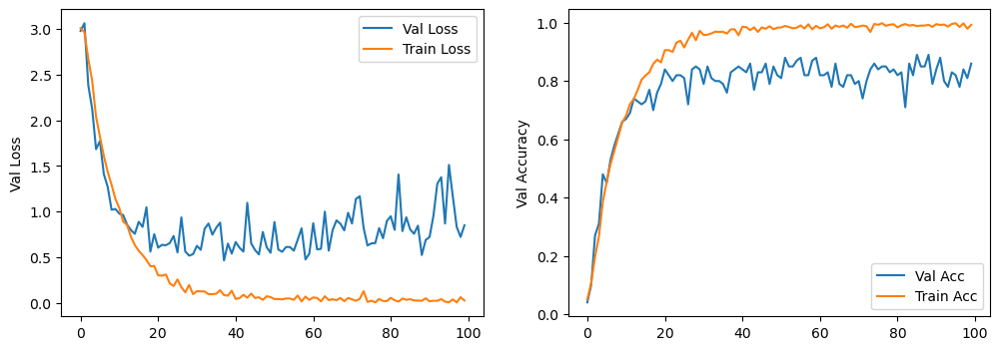

In [33]:
plot_loss(history_56)

### Prediction Evaluations

This new version of the model has provided signficant improvement on our classes as well. Most classes improved, and none got worse.

In [34]:
preds_56 = pred_eval(model_56, X= X_val_56)
correct_56 = count_correct(preds_56)

correct_overall['56'] = correct_56['Correct']

correct_overall.sort_values('56')

4/4 [==============================] - 0s 18ms/step


,Simple,Complex,Gray,56
y_true,,,,
D-ARNAUDS BARBET,3,3,2,3
CEDAR WAXWING,3,3,3,3
ALEXANDRINE PARAKEET,5,5,1,4
FRILL BACK PIGEON,2,4,3,4
BALD EAGLE,3,1,2,4
BLUE HERON,2,3,3,4
BOBOLINK,4,3,3,4
GAMBELS QUAIL,5,5,4,4
COPPERSMITH BARBET,4,5,1,4


### Images of Misclassified Birds

Looking at the two birds that got misclassified the most in this model, the misclassifications do make some sense. For isntance, the D-Arnauds Barbet that was misclassified as a Coppersmith Barbet seems like a mistake a human could make looking at the bird from that angle. 

Incorrectly labeled D-ARNAUDS BARBET


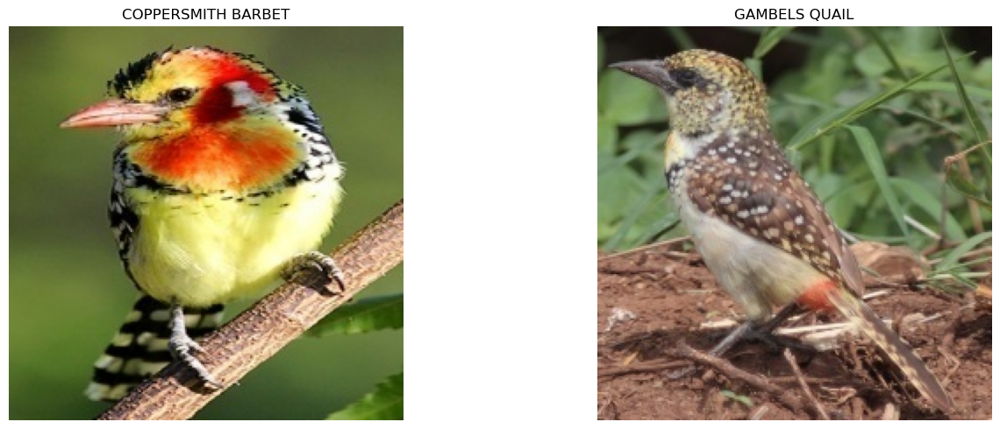

Correctly labeled D-ARNAUDS BARBET


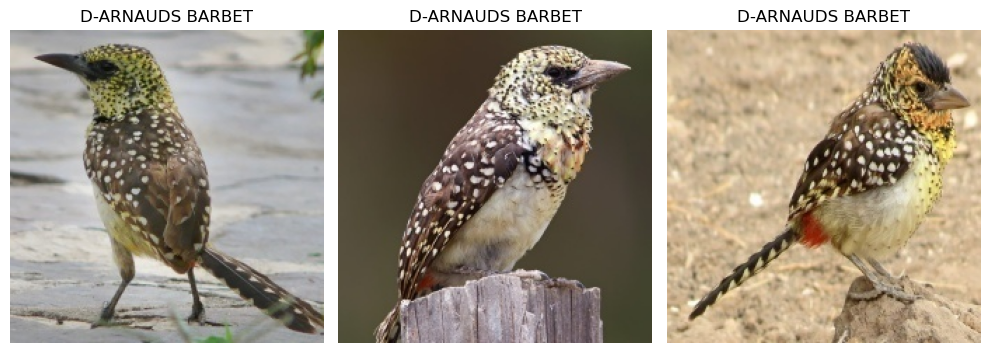

Incorrectly labeled CEDAR WAXWING


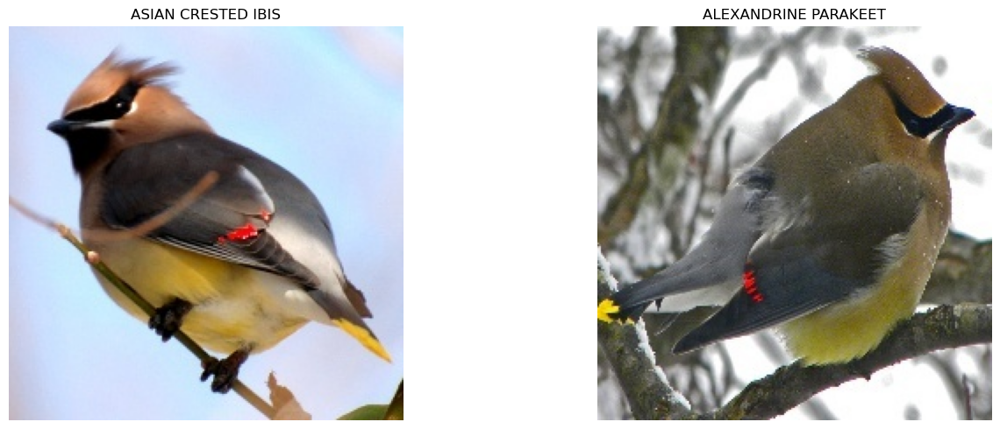

Correctly labeled CEDAR WAXWING


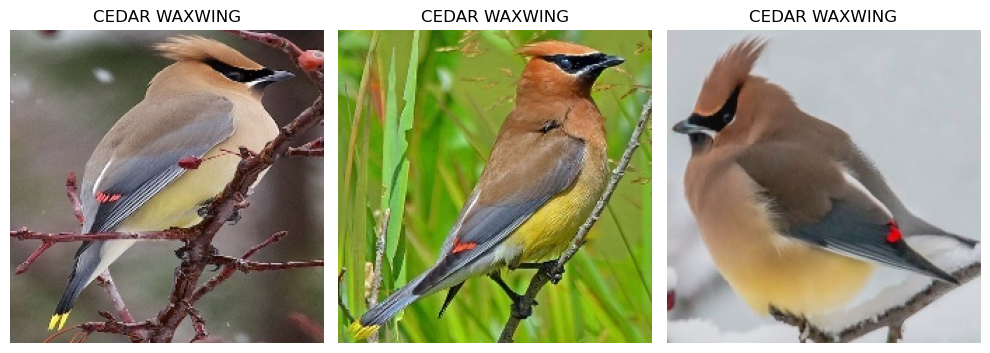

In [72]:
show_class('D-ARNAUDS BARBET', preds_56)

show_class('CEDAR WAXWING', preds_56)

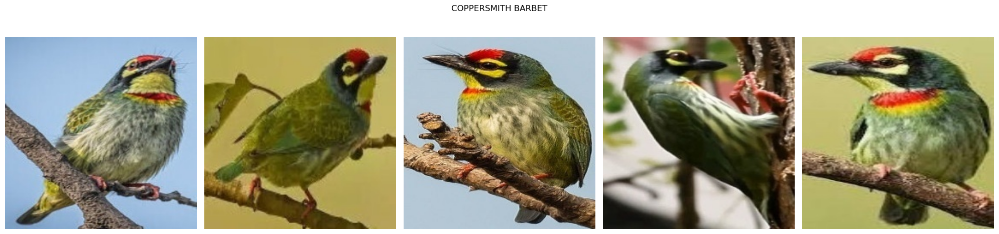

In [74]:
plot_birds(['COPPERSMITH BARBET'], 5)

## 112x112

The next step is to add a new layer as the new input that takes 112x112 images, performs a convolution and then uses MaxPooling to downscale the iamges to 56x56 again. 

To avoid picking up too much noise, we reduced the filter size on this model.

The weights of the trained 56x56 model are locked, so that they are not influenced by the features that the 112x112 model pulls out. 

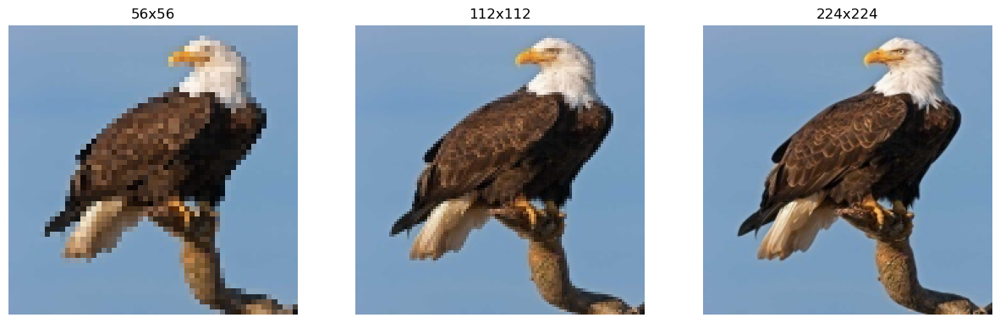

In [36]:
# Resize imags to 112x112

X_train_112, X_val_112 = resize_img(X_train, X_val, (112, 112))

# Compare to original data
fig, axs = plt.subplots(ncols=3, figsize = (15, 15))

# Compare to original data

axs[0].imshow(X_train_56[5])
axs[0].axis('off')
axs[0].set_title('56x56')

axs[1].imshow(X_train_112[5])
axs[1].axis('off')
axs[1].set_title('112x112')

axs[2].imshow(X_train[5])
axs[2].axis('off')
axs[2].set_title('224x224')

plt.show()

In [37]:
model_setup()

model = Sequential()

model.add(Conv2D(16, 3, padding='same', activation='leaky_relu', input_shape=(112, 112, 3)))

model.add(Conv2D(32, 3, padding='same', activation='leaky_relu'))

model.add(MaxPooling2D(2))

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 112, 112, 16)      448       
                                                                 
 conv2d_5 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 56, 56, 32)        0         
 g2D)                                                            
                                                                 
Total params: 5088 (19.88 KB)
Trainable params: 5088 (19.88 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [38]:
model_56 = keras.saving.load_model('model_56.keras')

# Check size of model:
print(f'End model has {len(model_56.layers)} layers\n')

# Check input sizes for first two layers
for layer in model_56.layers[:2]:
    print(layer.input)

# Add all layers except for input layer to the new model
for layer in model_56.layers[1:]:
    model.add(layer)

# Lock weights for model_56 layers
for layer in model.layers[-10:]:
    layer.trainable = False

model.summary()

End model has 11 layers

KerasTensor(type_spec=TensorSpec(shape=(None, 56, 56, 3), dtype=tf.float32, name='conv2d_input'), name='conv2d_input', description="created by layer 'conv2d_input'")
KerasTensor(type_spec=TensorSpec(shape=(None, 56, 56, 32), dtype=tf.float32, name=None), name='conv2d/LeakyRelu:0', description="created by layer 'conv2d'")
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 112, 112, 16)      448       
                                                                 
 conv2d_5 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 56, 56, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_1 (Conv2D)           (None, 

In [39]:
# Set callbacks

stopping, checkpoint = set_callbacks('model_112.keras')

model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics='accuracy')

history_112 = model.fit(x = X_train_112/255, y= y_train_vect, batch_size=128, validation_data= (X_val_112/255, y_val_vect), verbose = 1, epochs = 100, callbacks=[checkpoint])

Epoch 1/100
16/16 [==============================] - 7s 399ms/step - loss: 5.7147 - accuracy: 0.0975 - val_loss: 2.9342 - val_accuracy: 0.1600
Epoch 2/100
16/16 [==============================] - 6s 407ms/step - loss: 2.4164 - accuracy: 0.3020 - val_loss: 1.9593 - val_accuracy: 0.4500
Epoch 3/100
16/16 [==============================] - 7s 424ms/step - loss: 1.4529 - accuracy: 0.5570 - val_loss: 1.2689 - val_accuracy: 0.6100
Epoch 4/100
16/16 [==============================] - 6s 401ms/step - loss: 0.7909 - accuracy: 0.7830 - val_loss: 0.7977 - val_accuracy: 0.8100
Epoch 5/100
16/16 [==============================] - 6s 402ms/step - loss: 0.3816 - accuracy: 0.8805 - val_loss: 0.9181 - val_accuracy: 0.7600
Epoch 6/100
16/16 [==============================] - 6s 378ms/step - loss: 0.3239 - accuracy: 0.9010 - val_loss: 0.8537 - val_accuracy: 0.8200
Epoch 7/100
16/16 [==============================] - 6s 393ms/step - loss: 0.0903 - accuracy: 0.9720 - val_loss: 0.7386 - val_accuracy: 0.8100

In [40]:
model_112 = keras.saving.load_model('model_112.keras')

model_112.evaluate(X_val_112/255, y_val_vect)

4/4 [==============================] - 0s 24ms/step - loss: 0.6321 - accuracy: 0.9000


[0.632105827331543, 0.8999999761581421]

### Model Evaluation

This new layer improved the model again, increasing both accuracy and decreasing loss. It also appears that this new version is less prone to overfitting since it's only updating the weights for a single layer. 

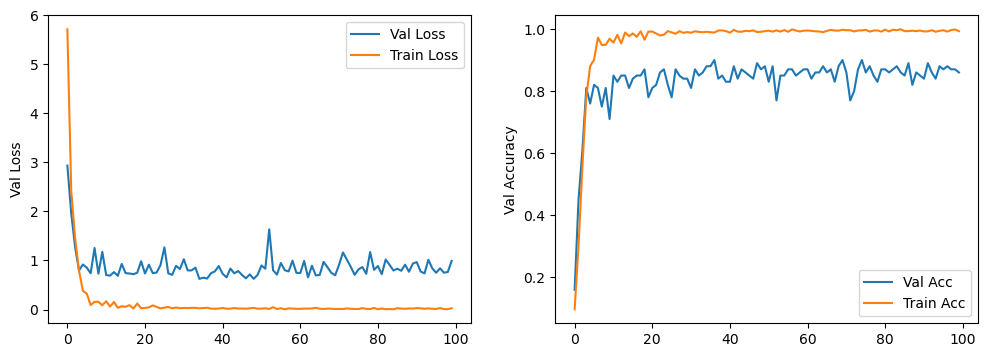

In [41]:
plot_loss(history_112)

### Prediction Evaluation

There is one calss that had a decrease in correct predictions, Campo Flicker, but in all other cases teh predictions either stayed the same or improved.

In [42]:
preds_112 = pred_eval(model_112, X= X_val_112)
correct_112 = count_correct(preds_112)

correct_overall['112'] = correct_112['Correct']

correct_overall.sort_values('112')

4/4 [==============================] - 0s 23ms/step


,Simple,Complex,Gray,56,112
y_true,,,,,
D-ARNAUDS BARBET,3,3,2,3,3
CEDAR WAXWING,3,3,3,3,3
ALEXANDRINE PARAKEET,5,5,1,4,4
COPPERSMITH BARBET,4,5,1,4,4
GAMBELS QUAIL,5,5,4,4,4
BOBOLINK,4,3,3,4,4
CAMPO FLICKER,4,5,2,5,4
BLUE HERON,2,3,3,4,4
BORNEAN PHEASANT,5,5,5,5,5


Incorrectly labeled CAMPO FLICKER


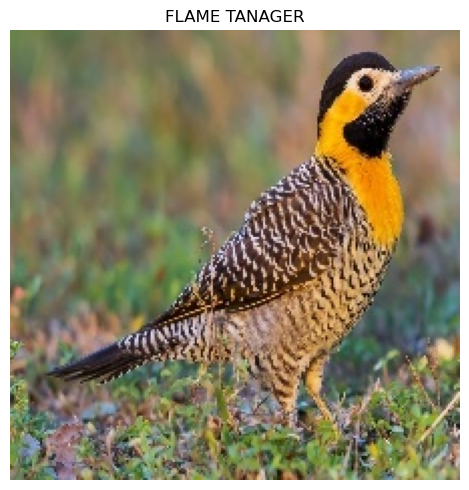

Correctly labeled CAMPO FLICKER


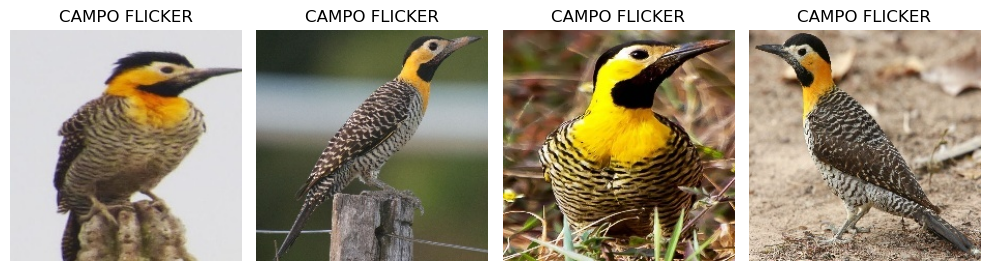

In [75]:
show_class('CAMPO FLICKER', preds_112)

## 224x224

For the final step, we added one CNN layer with a 224x224 input size, again using MaxPooling to scale the output down to 112x112. 

In [43]:
model_setup()

model = Sequential()

model.add(Conv2D(16, 3, padding='same', activation='leaky_relu', input_shape=(224, 224, 3)))

model.add(MaxPooling2D(2))

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 112, 112, 16)      0         
 g2D)                                                            
                                                                 
Total params: 448 (1.75 KB)
Trainable params: 448 (1.75 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [44]:
model_112 = keras.saving.load_model('model_112.keras')

# Check size of model:
print(f'End model has {len(model_112.layers)} layers\n')

# Check input sizes for first two layers
for layer in model_112.layers[:2]:
    print(layer.input)

# Add all layers except for input layer to the new model
for layer in model_112.layers[1:]:
    model.add(layer)

# Lock weights for model_56 layers
for layer in model.layers[2:]:
    layer.trainable = False

model.summary()

End model has 13 layers

KerasTensor(type_spec=TensorSpec(shape=(None, 112, 112, 3), dtype=tf.float32, name='conv2d_4_input'), name='conv2d_4_input', description="created by layer 'conv2d_4_input'")
KerasTensor(type_spec=TensorSpec(shape=(None, 112, 112, 16), dtype=tf.float32, name=None), name='conv2d_4/LeakyRelu:0', description="created by layer 'conv2d_4'")
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 112, 112, 16)      0         
 g2D)                                                            
                                                                 
 conv2d_5 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 max_pooling2d_3 (MaxP

In [45]:
# Set callbacks

stopping, checkpoint = set_callbacks('model_224.keras')

model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics='accuracy')

history_224 = model.fit(x = X_train/255, y= y_train_vect, batch_size=128, validation_data= (X_val/255, y_val_vect), verbose = 1, epochs = 100, callbacks=[checkpoint])

Epoch 1/100
16/16 [==============================] - 8s 450ms/step - loss: 5.2142 - accuracy: 0.5275 - val_loss: 0.8083 - val_accuracy: 0.8200
Epoch 2/100
16/16 [==============================] - 7s 436ms/step - loss: 0.1594 - accuracy: 0.9510 - val_loss: 0.5972 - val_accuracy: 0.8300
Epoch 3/100
16/16 [==============================] - 7s 444ms/step - loss: 0.0723 - accuracy: 0.9755 - val_loss: 0.6432 - val_accuracy: 0.8400
Epoch 4/100
16/16 [==============================] - 7s 463ms/step - loss: 0.0828 - accuracy: 0.9740 - val_loss: 0.6589 - val_accuracy: 0.8100
Epoch 5/100
16/16 [==============================] - 7s 436ms/step - loss: 0.0686 - accuracy: 0.9760 - val_loss: 0.5700 - val_accuracy: 0.8400
Epoch 6/100
16/16 [==============================] - 7s 456ms/step - loss: 0.0327 - accuracy: 0.9900 - val_loss: 0.5767 - val_accuracy: 0.8300
Epoch 7/100
16/16 [==============================] - 7s 449ms/step - loss: 0.0373 - accuracy: 0.9855 - val_loss: 0.5726 - val_accuracy: 0.8600

In [46]:
model_224 = keras.saving.load_model('model_224.keras')

model_224.evaluate(X_val/255, y_val_vect)

4/4 [==============================] - 0s 29ms/step - loss: 0.5862 - accuracy: 0.8800


[0.586241602897644, 0.8799999952316284]

### Model Evaluation

Unfortunately, the new layer decreased the accuracy that we'd gained in the previous model. However, the loss also decreased slightly, indicating that there were some features that had been helpful in getting the model closer to the ground truth even if it ultimately predicted more birds incorrectly. 

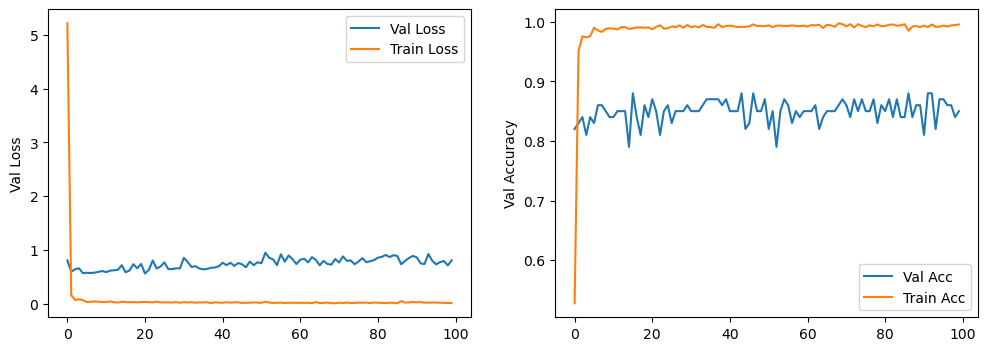

In [47]:
plot_loss(history_224)

### Prediction Evaluation

The decrease in accuracy appears to be an issue of Alexandrine Parakeet, Bald Ibis, and Bald Eagle. Blue Heron has actually been better predicted, and others have remained the same. 

In [48]:
preds_224 = pred_eval(model_224)
correct_224 = count_correct(preds_224)

correct_overall['224'] = correct_224['Correct']

correct_overall.sort_values('224')

4/4 [==============================] - 0s 27ms/step


,Simple,Complex,Gray,56,112,224
y_true,,,,,,
ALEXANDRINE PARAKEET,5,5,1,4,4,3
D-ARNAUDS BARBET,3,3,2,3,3,3
CEDAR WAXWING,3,3,3,3,3,3
COPPERSMITH BARBET,4,5,1,4,4,4
GAMBELS QUAIL,5,5,4,4,4,4
BOBOLINK,4,3,3,4,4,4
CAMPO FLICKER,4,5,2,5,4,4
BALD IBIS,4,2,4,5,5,4
BALD EAGLE,3,1,2,4,5,4


### Images of Misclassified Birds

Examining the birds that perfomred worse, it does appear that the model learned some odd features from the 224x224 images. While there are some similarities in some cases, some of the misclassifications indicate that model has picked out irrelavent features for its predictions. 

Incorrectly labeled BALD IBIS


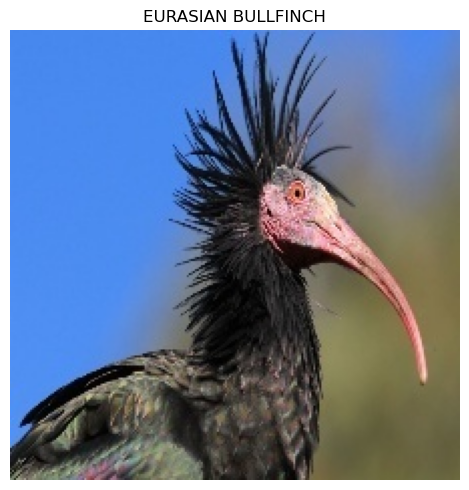

Correctly labeled BALD IBIS


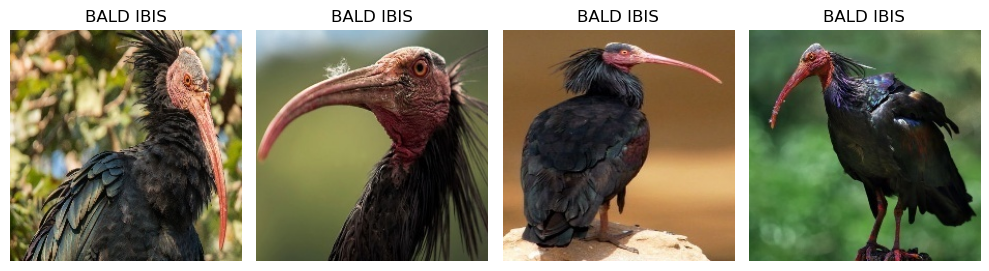

Incorrectly labeled BALD EAGLE


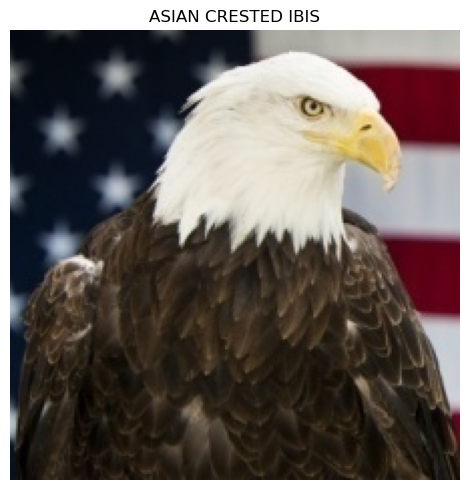

Correctly labeled BALD EAGLE


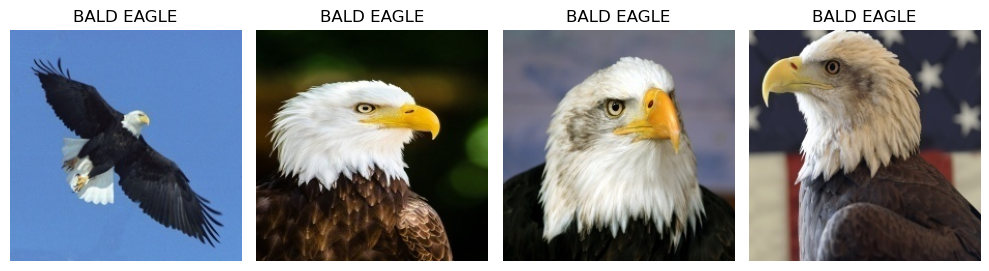

Incorrectly labeled ALEXANDRINE PARAKEET


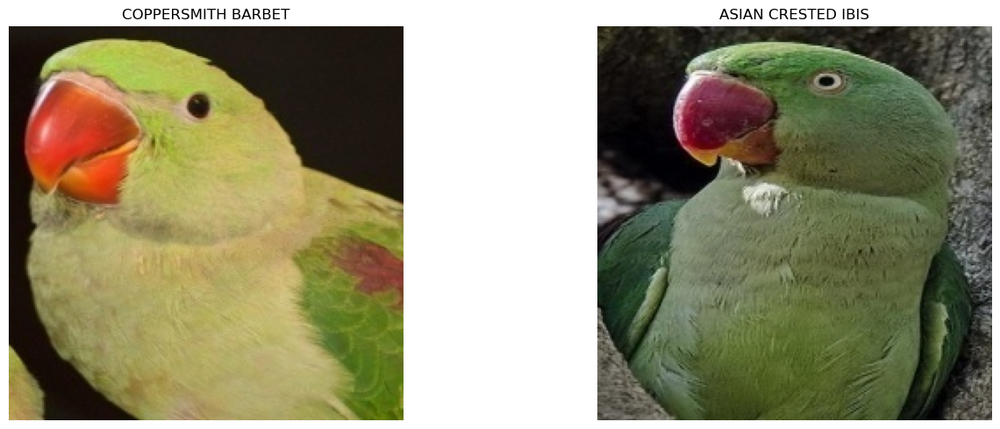

Correctly labeled ALEXANDRINE PARAKEET


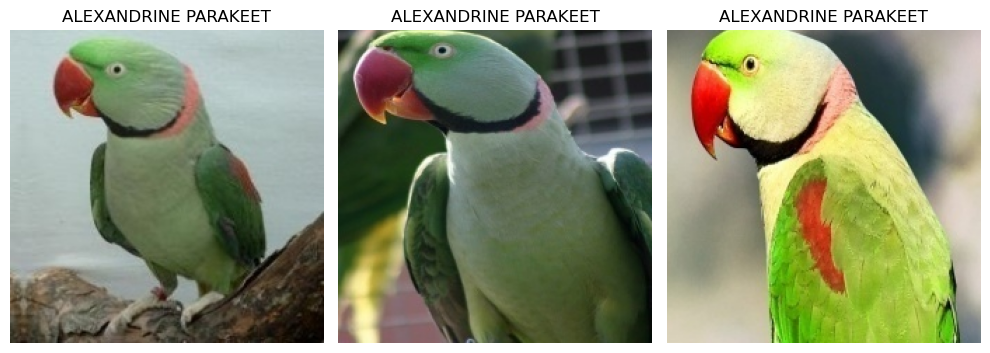

In [76]:
show_class('BALD IBIS', preds_224)

show_class('BALD EAGLE', preds_224)

show_class('ALEXANDRINE PARAKEET', preds_224)


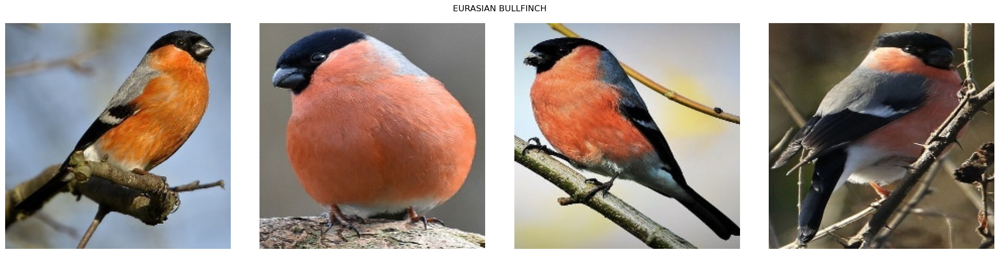

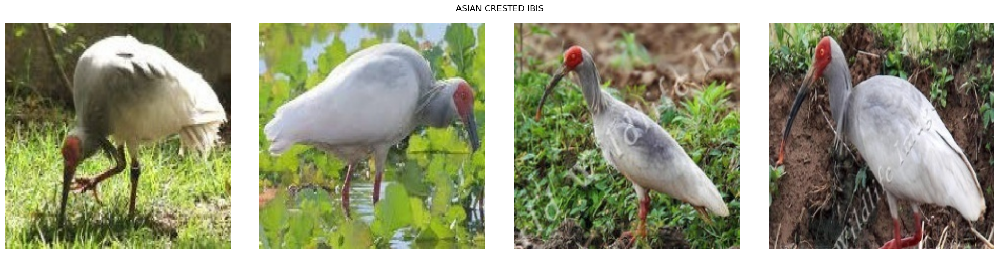

In [77]:
plot_birds(['EURASIAN BULLFINCH', 'ASIAN CRESTED IBIS'], 4)

# Add more Images

In reviewing the images that were poorly calssified across all three models, 2 in particular stood out: D-ARNAUDS BARBET and CEDAR WAXWING. To see if we could improve the version of the mode with the 224x224 layer, we decided to add 50 additional images of each of those birds to the training dataset. 

We then retrained the 224x224 model with the new data, and also unlocked teh weights of the 112x112 layer to see if we could get gains in both accuracy and loss by giving both layers more information. 

In [50]:
'''Original code to load additional data'''
# new_train_dir = "C:/Users/bcbot/COMP_4531/Final/100-bird-species/train"
# # Set the number of images per bird to include
# num_img = 50
# bird_list = ['CEDAR WAXWING', 'D-ARNAUDS BARBET']

# # Instantiate the containers for holding image and label data
# new_train_data = []

# bird_num = 0
# # Load train data
# for i in os.listdir(new_train_dir):
#     if i in bird_list:
#         count = 0
#         sub_directory = os.path.join(new_train_dir, i)
#         # Reverse the image order so we're getting different images than the first time
#         for j in os.listdir(sub_directory)[::-1]:
#             count+=1
#             if count > num_img:
#                 break
#             img = cv2.imread(os.path.join(sub_directory, j))
#             img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
#             new_train_data.append([img, i])

'Original code to load additional data'

In [51]:
# Load additional images
new_train_data = pickle.load(open('./saved_data/bird_new_train_data.pkl', 'rb'))

In [52]:
# Add images to training dataset
for item in new_train_data:
    train_data.append(item)

len(train_data)

2100

In [53]:
np.random.seed(rs)
np.random.shuffle(train_data)

# Preprocess training data and validation data
lb = LabelBinarizer()

X_train = []
y_train = []
for x, y in train_data:
    X_train.append(x)
    y_train.append(y)

X_train = np.array(X_train)
y_train = np.array(y_train)

y_train_vect = lb.fit_transform(y_train)

In [54]:
model_setup()

model = Sequential()

model.add(Conv2D(16, 3, padding='same', activation='leaky_relu', input_shape=(224, 224, 3)))

model.add(MaxPooling2D(2))

model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 112, 112, 16)      0         
 g2D)                                                            
                                                                 
Total params: 448 (1.75 KB)
Trainable params: 448 (1.75 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [55]:
model_112 = keras.saving.load_model('model_112.keras')

# Check size of model:
print(f'End model has {len(model_112.layers)} layers\n')

# Check input sizes for first two layers
for layer in model_112.layers[:2]:
    print(layer.input)

# Add all layers except for input layer to the new model
for layer in model_112.layers[1:]:
    model.add(layer)

# Lock weights for model_56 layers
for layer in model.layers[3:]:
    layer.trainable = False

model.summary()

End model has 13 layers

KerasTensor(type_spec=TensorSpec(shape=(None, 112, 112, 3), dtype=tf.float32, name='conv2d_4_input'), name='conv2d_4_input', description="created by layer 'conv2d_4_input'")
KerasTensor(type_spec=TensorSpec(shape=(None, 112, 112, 16), dtype=tf.float32, name=None), name='conv2d_4/LeakyRelu:0', description="created by layer 'conv2d_4'")
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 224, 224, 16)      448       
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 112, 112, 16)      0         
 g2D)                                                            
                                                                 
 conv2d_5 (Conv2D)           (None, 112, 112, 32)      4640      
                                                                 
 max_pooling2d_3 (MaxP

In [56]:
# Set callbacks

stopping, checkpoint = set_callbacks('model_new_img.keras')

model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics='accuracy')

history_new_img = model.fit(x = X_train/255, y= y_train_vect, batch_size=128, validation_data= (X_val/255, y_val_vect), verbose = 1, epochs = 100, callbacks=[checkpoint])

Epoch 1/100
17/17 [==============================] - 9s 514ms/step - loss: 2.6104 - accuracy: 0.7510 - val_loss: 0.8052 - val_accuracy: 0.7600
Epoch 2/100
17/17 [==============================] - 9s 525ms/step - loss: 0.2933 - accuracy: 0.9314 - val_loss: 0.6742 - val_accuracy: 0.8600
Epoch 3/100
17/17 [==============================] - 9s 515ms/step - loss: 0.3987 - accuracy: 0.9214 - val_loss: 0.6869 - val_accuracy: 0.8600
Epoch 4/100
17/17 [==============================] - 8s 499ms/step - loss: 0.1782 - accuracy: 0.9662 - val_loss: 0.8370 - val_accuracy: 0.8000
Epoch 5/100
17/17 [==============================] - 8s 490ms/step - loss: 0.2818 - accuracy: 0.9400 - val_loss: 0.8272 - val_accuracy: 0.8100
Epoch 6/100
17/17 [==============================] - 9s 514ms/step - loss: 0.2012 - accuracy: 0.9524 - val_loss: 0.6672 - val_accuracy: 0.8300
Epoch 7/100
17/17 [==============================] - 8s 498ms/step - loss: 0.2840 - accuracy: 0.9390 - val_loss: 0.6120 - val_accuracy: 0.8400

## Model Evaluation

Adding the extra images did in fact increase accuracy and decrease loss. The mdoel was now performing at 91% with a loss of .39, our best scores yet.  

In [57]:
mod_new_img = keras.saving.load_model('model_new_img.keras')

mod_new_img.evaluate(X_val/255, y_val_vect)

4/4 [==============================] - 1s 47ms/step - loss: 0.3924 - accuracy: 0.9100


[0.3924221098423004, 0.9100000262260437]

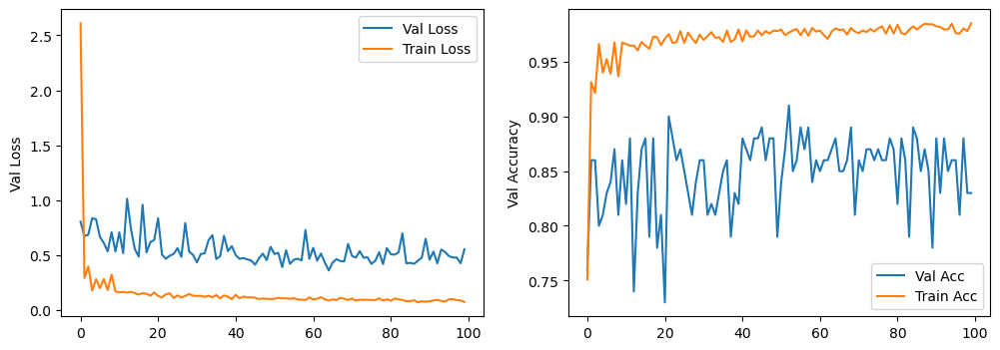

In [58]:
plot_loss(history_new_img)

## Prediction Evaluations

Looking at the new predictions, these additional images and training seemed to have a net positive on the model. While the Barbet did not improve, the Waxwing did. And wiht one exception (the Blue Heron), all our classes either improved or remained the same from the 224x224 model. 

In [59]:
new_img_preds = pred_eval(mod_new_img)
new_img_correct = count_correct(new_img_preds)

correct_overall['new_img'] = new_img_correct['Correct']

correct_overall.sort_values(by='new_img')

4/4 [==============================] - 0s 42ms/step


,Simple,Complex,Gray,56,112,224,new_img
y_true,,,,,,,
D-ARNAUDS BARBET,3,3,2,3,3,3,3
ALEXANDRINE PARAKEET,5,5,1,4,4,3,4
BALD EAGLE,3,1,2,4,5,4,4
BLUE HERON,2,3,3,4,4,5,4
BOBOLINK,4,3,3,4,4,4,4
GAMBELS QUAIL,5,5,4,4,4,4,4
CEDAR WAXWING,3,3,3,3,3,3,4
COPPERSMITH BARBET,4,5,1,4,4,4,4
FRILL BACK PIGEON,2,4,3,4,5,5,5


# Final Model Test

With an accuracy 10% points higher than our inital model, we decide to do a final evaluation on our test set. 

In [62]:
np.random.seed(rs)
np.random.shuffle(test_data)

X_test = []
y_test = []
for x, y in test_data:
    X_test.append(x)
    y_test.append(y)

X_test = np.array(X_test)
y_test = np.array(y_test)

y_test_vect = lb.fit_transform(y_test)

## Results Evaluation

Unfortunately, the model did not perform as well on our test set as it did on the validation set and we achieved an accuracy of only 83%. While some classes did very well, and some that had been consistently poor (D-Arnauds Barbet) did better, many classes saw significant decreases. 

Blue Heron and Bobolink in particular has significant drops and became our most poorly predicted classes. 

In [63]:
mod_new_img.evaluate(X_test/255, y_test_vect)

1/4 [======>.......................] - ETA: 0s - loss: 0.9380 - accuracy: 0.8125

4/4 [==============================] - 0s 30ms/step - loss: 0.5899 - accuracy: 0.8300


[0.5899484157562256, 0.8299999833106995]

In [64]:
final_preds = pred_eval(mod_new_img, X_test, y_test)
final_correct = count_correct(final_preds)

correct_overall['Test'] = final_correct['Correct']

correct_overall.sort_values('Test')

4/4 [==============================] - 0s 28ms/step


,Simple,Complex,Gray,56,112,224,new_img,Test
y_true,,,,,,,,
BLUE HERON,2,3,3,4,4,5,4,2
BOBOLINK,4,3,3,4,4,4,4,2
BALD IBIS,4,2,4,5,5,4,5,3
CALIFORNIA QUAIL,5,5,5,5,5,5,5,3
ALEXANDRINE PARAKEET,5,5,1,4,4,3,4,4
FRILL BACK PIGEON,2,4,3,4,5,5,5,4
EURASIAN BULLFINCH,5,5,4,5,5,5,5,4
COPPERSMITH BARBET,4,5,1,4,4,4,4,4
GAMBELS QUAIL,5,5,4,4,4,4,4,4


## Class Evaluation

Exploring the two worst predicted classes, we noticed that one of the issues appeared to be distinct differences between the images in the validation and teh test set. For instance, the positions of the blue heron in the test and validation set were very different, and the Bobolinks were in very different positions that showed very different parts of the coloration and patterning. 

It appeared that we had overfit the validation in our model training, and while we had made the model slightly more flexible, we still trained it to recognize specific features that were not conistent across the validation and test set. 

Incorrectly labeled BLUE HERON


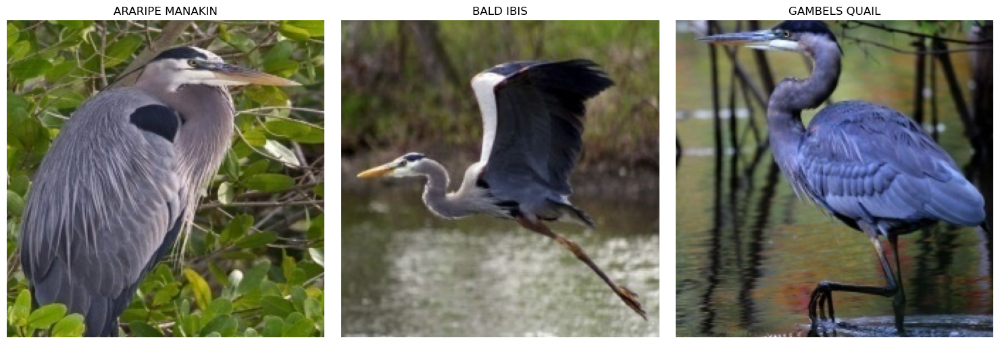

Correctly labeled BLUE HERON


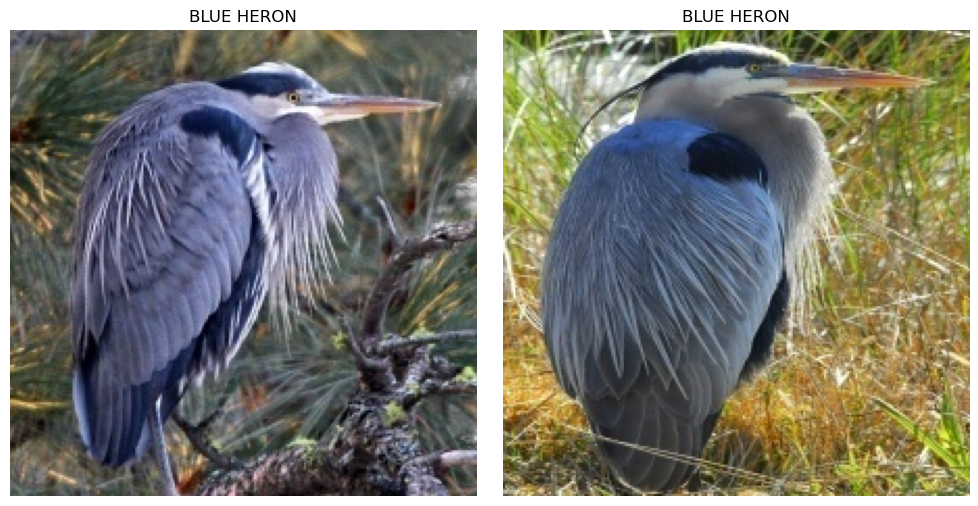

Incorrectly labeled BOBOLINK


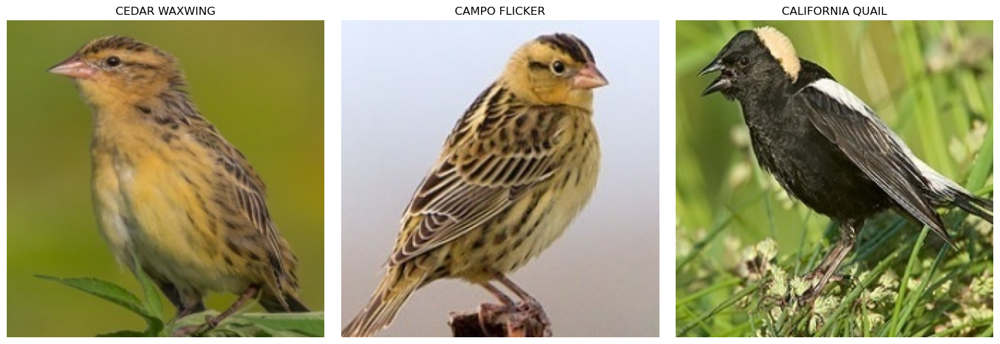

Correctly labeled BOBOLINK


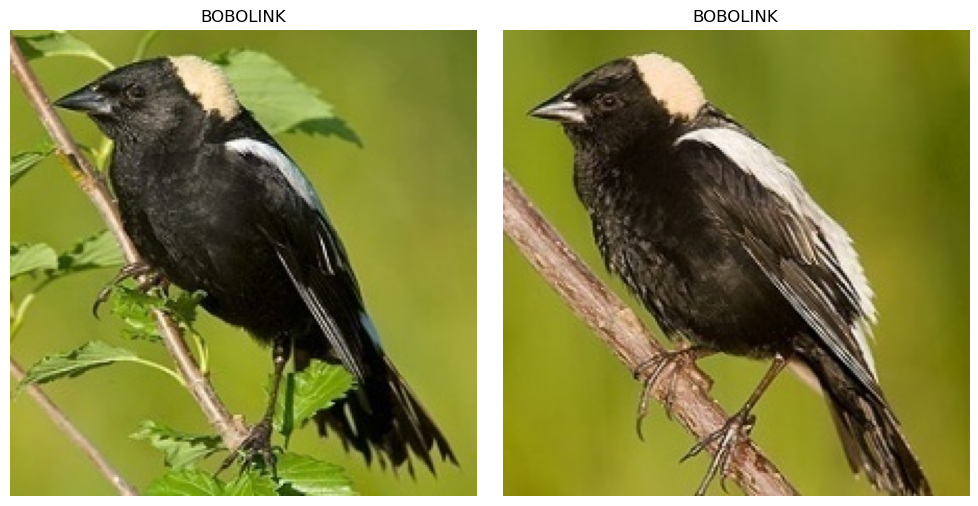

In [79]:
show_class('BLUE HERON', final_preds, X_test)

show_class('BOBOLINK', final_preds, X_test)

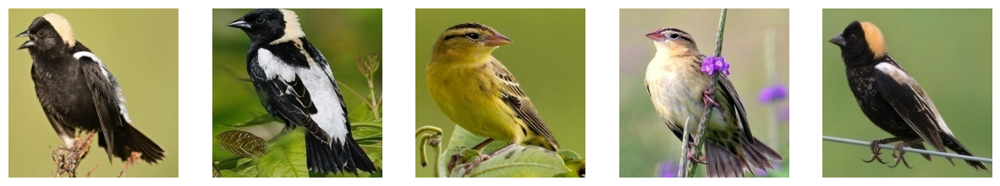

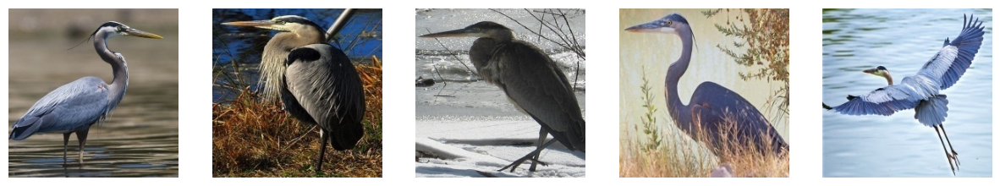

In [89]:
fig, axs = plt.subplots(ncols = 5, figsize= (15, 5))
axs = axs.ravel()

for idx, i in enumerate(X_val[y_val == 'BOBOLINK']):
    axs[idx].imshow(i)
    axs[idx].axis('off')

plt.show()

fig, axs = plt.subplots(ncols = 5, figsize= (15, 5))
axs = axs.ravel()

for idx, i in enumerate(X_val[y_val == 'BLUE HERON']):
    axs[idx].imshow(i)
    axs[idx].axis('off')

plt.show()